# Shap testing 5

## all about ISM

First implementing ISM in the utility class to calculate things

Testing various inputs/outputs

Making plots that can take in multiple models and compares them all

In [25]:
#we will create a utility function for shap called shap_utils.py
#you define several attributes, and then it will load the data to be able to access the shap values

import torch 
import sys
import yaml 
sys.path.append('/data/leslie/sarthak/hyena/hyena-dna/')
from src.tasks.decoders import SequenceDecoder
from src.models.sequence.dna_embedding import DNAEmbeddingModel
from src.dataloaders.datasets.hg38_char_tokenizer import CharacterTokenizer
# import shap
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import logomaker

class ISMUtils():
    def __init__(self, model_type, ckpt_path, cfg = None, split = 'train', filter=True):
        type_list = ['ccre', 'DNase_ctst', 'DNase_allcelltypes', 'DNase']
        if model_type not in type_list:
            raise ValueError('Model type not recognized')
        i.mtype = model_type
        if cfg is not None:
            cfg = '/data/leslie/sarthak/hyena/hyena-dna/configs/evals/'+cfg
        
        #check to see the type, and then load the right tokenizer, class and cfg
        if self.mtype == 'DNase':
            from src.dataloaders.datasets.DNase_dataset import DNaseDataset as DatasetClass
            self.tokenizer = CharacterTokenizer( #make sure to fix the tokenizer too
                characters=['A', 'C', 'G', 'T', 'N', 'S', 'U', 'V', 'W', 'X', 'Y', 'Z'],
                model_max_length=1024 + 2,  # add 2 since default adds eos/eos tokens, crop later
                add_special_tokens=False,
                padding_side='left'
            )
            if cfg is None:
                cfg = '/data/leslie/sarthak/hyena/hyena-dna/configs/evals/DNase.yaml'
                
        elif self.mtype == 'DNase_allcelltypes':
            from src.dataloaders.datasets.DNase_allcelltypes import DNaseAllCellTypeDataset as DatasetClass
            self.tokenizer = CharacterTokenizer( #make sure to fix the tokenizer too
                characters=['A', 'C', 'G', 'T', 'N'],
                model_max_length=1024 + 2,  # add 2 since default adds eos/eos tokens, crop later
                add_special_tokens=False,
                padding_side='left'
            )
            if cfg is None:
                cfg = '/data/leslie/sarthak/hyena/hyena-dna/configs/evals/DNase_allcelltypes.yaml'

        elif self.mtype == 'Dnase_ctst':
            from src.dataloaders.datasets.DNase_ctst_dataset import DNaseCtstDataset as DatasetClass
            self.tokenizer = CharacterTokenizer( #make sure to fix the tokenizer too
                characters=['A', 'C', 'G', 'T', 'N'],
                model_max_length=1024 + 2,  # add 2 since default adds eos/eos tokens, crop later
                add_special_tokens=False,
                padding_side='left'
            )
            if cfg is None:
                cfg = '/data/leslie/sarthak/hyena/hyena-dna/configs/evals/DNase_ctst.yaml'

        else:
            raise ValueError('Model type not recognized')

        #now we load the model and dataset

        # self.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.dataset = DatasetClass(max_length = 1024, split = split, tokenizer=self.tokenizer, rc_aug = False, tokenizer_name='char', add_eos='True', filter = filter)
        cfg = yaml.load(open(cfg, 'r'), Loader=yaml.FullLoader)
        
        train_cfg = cfg['train']  # grab section `train` section of config
        model_cfg = cfg['model_config']  # grab the `model` section of config
        d_output = train_cfg['d_output']
        backbone = DNAEmbeddingModel(**model_cfg)
        # backbone_skip = DNAEmbeddingModel(skip_embedding=True, **model_cfg)
        decoder = SequenceDecoder(model_cfg['d_model'], d_output=d_output, l_output=0, mode='pool')
        state_dict = torch.load(ckpt_path, map_location='cpu')  # has both backbone and decoder
        
        # loads model from ddp by removing prexix to single if necessary
        torch.nn.modules.utils.consume_prefix_in_state_dict_if_present(
            state_dict["state_dict"], "model."
        )

        model_state_dict = state_dict["state_dict"]

        # need to remove torchmetrics. to remove keys, need to convert to list first
        for key in list(model_state_dict.keys()):
            if "torchmetrics" in key:
                model_state_dict.pop(key)

        # the state_dict keys slightly mismatch from Lightning..., so we fix it here
        decoder_state_dict = {}
        decoder_state_dict['output_transform.weight'] = model_state_dict.pop('decoder.0.output_transform.weight')
        decoder_state_dict['output_transform.bias'] = model_state_dict.pop('decoder.0.output_transform.bias')

        #now adjust the backbone if needed
        if self.mtype == 'DNase':
            embedding1 = torch.nn.Embedding(20, 128)
            # embedding2 = torch.nn.Embedding(20, 128)
            backbone.backbone.embeddings.word_embeddings = embedding1 #again a hack
            # backbone_skip.backbone.embeddings.word_embeddings = embedding2 #again a hack

        # now actually load the state dict to the decoder and backbone separately
        decoder.load_state_dict(decoder_state_dict, strict=True)
        backbone.load_state_dict(model_state_dict, strict=True)

        self.backbone = backbone.eval()
        self.decoder = decoder.eval()

        self.bed = pd.read_csv('/data/leslie/sarthak/data/GRCh38-cCREs.bed', header=None, delimiter='\t').to_numpy()
        self.middle = 1023//2 #just used for the logo plots

    def calculate_ISM(self,ccre, cuda = False, return_out = False):
        #does ISM for that ccre, based on the model type
        #Does what the ISM.py and ISM_allcelltypes.py files do but for one ccre at a time
        #ccre should be the index of the ccre, not the index to get that dataset
        device = "cuda:0" if cuda else "cpu"
        backbone = self.backbone.to(device)
        decoder = self.decoder.to(device)
        #first have to load in the batch
        #if it's the different groups have very different dataset classes
        if self.mtype == 'DNase':
            ccre = 161*ccre
            ccre_list = []
            out_list = []
            for i in range(161):
                a,b = self.dataset[ccre+i]
                ccre_list.append(a)
                out_list.append(b.item())
            ccre_list = torch.stack(ccre_list).to(device)
        else:
            ccre_list = self.dataset[ccre][0].unsqueeze(0).to(device)

        temp,_ = backbone(ccre_list)
        out = decoder(temp)

        out_gt_np = out.detach().cpu().numpy().reshape(1, 1, 161) #the initial output of the model before ism
        
        return ccre_list, out_gt_np
        #now we can calculate the ISM
        #we add someway to return the output of the model as well if we want to
        if return_out: #but this is optional
            return out

    def var(self, idx):
        #This is the idx for the ccre, so if you want it for ccre 2 it's just idx == 2. Not 161*idx
        seq_idx = idx
        cCRE_id = self.dataset.array[seq_idx][0] #get the id from the array
        row = self.dataset.cCRE_dict[cCRE_id]
        #now we can calculate the variance using this data
        # print(np.var(dnase_filtered[row,:])) #identical
        
        return np.var(self.dataset.cell_dnase_levels[row,:])

    def output(self,idx):
        #given the index, this finds the associated output (single value)
        a,b = self.dataset[idx]
        temp,_ = self.backbone(a.unsqueeze(0))
        out = self.decoder(temp)

        if self.mtype == 'DNase':
            print(f'predicted output: {out}, actual output: {b}')
            return b, out

        elif self.mtype == 'DNase_allcelltypes':
            print(f'predicted output: {out[0,0]}, actual output: {b[0]}')
            return b[0], out[0,0]

    def output_all(self,idx):
        #given the index, this finds the associated output (all values averaged across the cell types for a singel ccre)
        #if it's DNase, then we need to do it for all the cell types, here the input idx should be 161 times any number
        if self.mtype == 'DNase':
            #first check to make sure idx is divisible by 161
            if idx % 161 != 0:
                raise ValueError('Index not divisible by 161')
            out_list = []
            target_list = []
            for i in range(161):
                a,b = self.dataset[idx+i]
                temp,_ = self.backbone(a.unsqueeze(0))
                out = self.decoder(temp)
                out_list.append(out.item())
                target_list.append(b.item())
            out = np.mean(out_list)
            print(f'predicted output mean: {out}, actual output mean: {np.mean(target_list)}')
            #but return the whole lists
            return np.array(target_list), np.array(out_list)

        if self.mtype == 'DNase_allcelltypes':
            a,b = self.dataset[idx]
            temp,_ = self.backbone(a.unsqueeze(0))
            out = self.decoder(temp)
            print(f'predicted output mean: {torch.mean(out)}, actual output mean: {torch.mean(b)}')
            return b.detach().numpy(), out.detach().numpy()

    def plot_singlecelltype(self, data, celltype = 0):
        #given the index, this finds the associated output (single value)
        #we can either take in the actual data, or the ccre number
        #actual data must be formatted the same as the saved data
        if type(data) == int:
            data_loaded = np.load(f'/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_{data}.npy')
        elif type(data) == np.ndarray: #you can also just give it the data and then it doesn't need to load it
            data_loaded = data
        fig, ax = plt.subplots(1,1, figsize = (20,10))
        sns.heatmap(data_loaded[:,:,celltype], cmap = 'seismic', center = 0)
        plt.yticks([0.5,1.5,2.5,3.5],['A','C','G','T'])
        plt.xlabel('sequence position')
        plt.title(f'ISM scores for the {celltype} cell type of the {data} ccre')
        plt.show()

    def plot_all(self,data):
        #once again can give the ccre or the actual data
        if type(data) == int:
            data_loaded = np.load(f'/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_{data}.npy')
        elif type(data) == np.ndarray:
            data_loaded = data
        fig, ax = plt.subplots(1,1, figsize = (20,10))
        sns.heatmap(data_loaded.sum(axis = 0).T, cmap = 'seismic', center = 0)
        plt.ylabel('celltype')
        plt.xlabel('sequence position')
        plt.title('ISM scores for all cell types single ccre')
        plt.show()

    def default_heights(self,data):
        #it will sum across the nucelotides and average over the celltypes
        if type(data) == int:
            data_loaded = np.load(f'/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_{data}.npy')
        elif type(data) == np.ndarray:
            data_loaded = data
        return data_loaded.sum(axis = 0).mean(axis = 1)

    def logoplot(self,ccre,heights = None, startend=None,flip_heights = False): #potentially we add the title as an input into the model
        #so given the ccre number and the heights, this will plot the logo plot
        #note ccre should be the ccre number regardless of the model type
        #heights must be provided, is usually the sum across the axis=1 for the data that is used for plot_all, uses same start and end
        if self.mtype == 'DNase':
            ccre = 161*ccre
        a,b = self.dataset[ccre]
        seq=self.dataset.tokenizer.decode(a)
        if startend is None and self.mtype == 'DNase':
            start = self.middle-50+4
            end = self.middle+50+4
        elif startend is None and self.mtype == 'DNase_allcelltypes':
            start = self.middle-50
            end = self.middle+50
        elif self.mtype == 'DNase': #if specify it, add 4 to the dnase, just so aligns with the multitasking model
            start = startend[0]+4
            end = startend[1]+4
        else:
            start = startend[0]
            end = startend[1]

        #now we can define cut_seq
        cut_seq = seq[start:end]
                    
        if heights is None:
            raise ValueError('Need to provide heights')

        #now we define cut heights
        heights = heights[start:end]
        if flip_heights:
            heights = -heights
        logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)

        # Fill the DataFrame with heights, converting heights to float if necessary
        for i, symbol in enumerate(cut_seq):
            logo_df.loc[i, symbol] = heights[i]

        # Generate the sequence logo
        # fig, ax = 
        # fig.set_size_inches(20, 3)  # Set the desired width and height here        
        logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below = True, figsize = (20,3))
        plt.title('Sequence logo')
        # fig.show()
    
    def find_ccre_type(self, idx):
        #this function will use the ccre id to find the specific type
        #uses the index of the dataset, not the cCRE for the DNase model!!
        #first get the id
        if self.mtype == 'DNase':        
            seq_idx = int(idx/self.dataset.cell_types)
        else:
            seq_idx = idx
        ccre_id = self.dataset.array[seq_idx][0]
        line = np.where(self.bed[:,3] == ccre_id)
        return self.bed[line[0][0], -1]

In [27]:
#test it on various ccREs and compare it to the saved values
#first for the non all cell type
multitasking_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-23/09-35-33-196632/checkpoints/381-val_loss=3.57483.ckpt'
cts_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-29/15-45-02-282170/checkpoints/last.ckpt'
cts_path2 = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-09/17-38-16-568113/checkpoints/last.ckpt' #this is again the 10% 100 epochs one
ctst_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-23/09-35-11-173861/checkpoints/last.ckpt'

#let's try the ctst path
util_cts = ISMUtils('DNase',cts_path, cfg = 'DNase_full.yaml')

In [28]:
#first we do the old one so we have a comparison
util_cts2 = ISMUtils('DNase',cts_path2)


In [29]:
#now we calculate ISM
ccre_list, out_gt_np = util_cts.calculate_ISM(0)

In [30]:
ccre_list #it's the list of sequences, this isn't what we want, just had it return it in the past like this, again this is just for testing

tensor([[12, 13, 14,  ...,  7, 10,  9],
        [12, 13, 14,  ...,  7, 10,  9],
        [12, 13, 14,  ...,  7, 10,  9],
        ...,
        [12, 14, 15,  ...,  7, 10,  9],
        [12, 14, 15,  ...,  7, 10,  9],
        [12, 14, 15,  ...,  7, 10,  9]])

In [31]:
#the sequences are identical, but the permutations differ
ccre_list, out_gt_np = util_cts2.calculate_ISM(0)

In [32]:
ccre_list #want it to be completely identical

tensor([[12, 13, 14,  ...,  7, 10,  9],
        [12, 13, 14,  ...,  7, 10,  9],
        [12, 13, 14,  ...,  7, 10,  9],
        ...,
        [12, 14, 15,  ...,  7, 10,  9],
        [12, 14, 15,  ...,  7, 10,  9],
        [12, 14, 15,  ...,  7, 10,  9]])

In [48]:
ccre_list.shape

torch.Size([161, 1023])

In [33]:
#now for the first ccre
ccre_list, out_gt_np = util_cts2.calculate_ISM(1)
ccre_list #same permutations, different sequences, it's perfect

tensor([[12, 13, 14,  ...,  7,  9,  8],
        [12, 13, 14,  ...,  7,  9,  8],
        [12, 13, 14,  ...,  7,  9,  8],
        ...,
        [12, 14, 15,  ...,  7,  9,  8],
        [12, 14, 15,  ...,  7,  9,  8],
        [12, 14, 15,  ...,  7,  9,  8]])

In [35]:
#just make sure it's all the same, check to see if all the rows are identical
torch.min(ccre_list[0,8:] == ccre_list[-1,8:]) #should be True, and it is

tensor(True)

In [37]:
torch.all(torch.eq(ccre_list[0,8:], ccre_list[-1,8:])) #should be True, and it is, can use tolerance using torch.allclose

tensor(True)

In [38]:
torch.allclose(ccre_list[0,8:], ccre_list[-1,8:], atol = 1e-5) #should be True, and it is

True

In [39]:
#of course now we manually load in the ccre
ccre1 = util_cts2.dataset[161*1][0]
ccre1

tensor([12, 13, 14,  ...,  7,  9,  8])

In [40]:
torch.allclose(ccre_list[0], ccre1, atol = 1e-5) #should be True, and it is

True

In [42]:
out_gt_np.shape #looks fine, we can compare the index 1 to our output

(1, 1, 161)

In [47]:
# b = util_cts2.dataset[0][1]
# print(b)
# print(out_gt_np[0,0,0]) #should be the same, and it is

tensor([-10.])
-2.210046


# finishing ism and testing the outputs to see if identical

In [102]:
#so loads this in properly
#we will create a utility function for shap called shap_utils.py
#you define several attributes, and then it will load the data to be able to access the shap values

import torch 
import sys
import yaml 
sys.path.append('/data/leslie/sarthak/hyena/hyena-dna/')
from src.tasks.decoders import SequenceDecoder
from src.models.sequence.dna_embedding import DNAEmbeddingModel
from src.dataloaders.datasets.hg38_char_tokenizer import CharacterTokenizer
# import shap
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import logomaker
from tqdm import tqdm

class ISMUtils():
    def __init__(self, model_type, ckpt_path, cfg = None, split = 'train', filter=True):
        type_list = ['ccre', 'DNase_ctst', 'DNase_allcelltypes', 'DNase']
        if model_type not in type_list:
            raise ValueError('Model type not recognized')
        self.mtype = model_type
        if cfg is not None:
            cfg = '/data/leslie/sarthak/hyena/hyena-dna/configs/evals/'+cfg
        
        #check to see the type, and then load the right tokenizer, class and cfg
        if self.mtype == 'DNase':
            from src.dataloaders.datasets.DNase_dataset import DNaseDataset as DatasetClass
            self.tokenizer = CharacterTokenizer( #make sure to fix the tokenizer too
                characters=['A', 'C', 'G', 'T', 'N', 'S', 'U', 'V', 'W', 'X', 'Y', 'Z'],
                model_max_length=1024 + 2,  # add 2 since default adds eos/eos tokens, crop later
                add_special_tokens=False,
                padding_side='left'
            )
            if cfg is None:
                cfg = '/data/leslie/sarthak/hyena/hyena-dna/configs/evals/DNase.yaml'
                
        elif self.mtype == 'DNase_allcelltypes':
            from src.dataloaders.datasets.DNase_allcelltypes import DNaseAllCellTypeDataset as DatasetClass
            self.tokenizer = CharacterTokenizer( #make sure to fix the tokenizer too
                characters=['A', 'C', 'G', 'T', 'N'],
                model_max_length=1024 + 2,  # add 2 since default adds eos/eos tokens, crop later
                add_special_tokens=False,
                padding_side='left'
            )
            if cfg is None:
                cfg = '/data/leslie/sarthak/hyena/hyena-dna/configs/evals/DNase_allcelltypes.yaml'

        elif self.mtype == 'DNase_ctst':
            from src.dataloaders.datasets.DNase_ctst_dataset import DNaseCtstDataset as DatasetClass
            self.tokenizer = CharacterTokenizer( #make sure to fix the tokenizer too
                characters=['A', 'C', 'G', 'T', 'N'],
                model_max_length=1024 + 2,  # add 2 since default adds eos/eos tokens, crop later
                add_special_tokens=False,
                padding_side='left'
            )
            if cfg is None:
                cfg = '/data/leslie/sarthak/hyena/hyena-dna/configs/evals/DNase_ctst.yaml'

        else:
            raise ValueError('Model type not recognized')

        #now we load the model and dataset

        # self.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.dataset = DatasetClass(max_length = 1024, split = split, tokenizer=self.tokenizer, rc_aug = False, tokenizer_name='char', add_eos='True', filter = filter)
        cfg = yaml.load(open(cfg, 'r'), Loader=yaml.FullLoader)
        
        train_cfg = cfg['train']  # grab section `train` section of config
        model_cfg = cfg['model_config']  # grab the `model` section of config
        d_output = train_cfg['d_output']
        backbone = DNAEmbeddingModel(**model_cfg)
        # backbone_skip = DNAEmbeddingModel(skip_embedding=True, **model_cfg)
        decoder = SequenceDecoder(model_cfg['d_model'], d_output=d_output, l_output=0, mode='pool')
        state_dict = torch.load(ckpt_path, map_location='cpu')  # has both backbone and decoder
        
        # loads model from ddp by removing prexix to single if necessary
        torch.nn.modules.utils.consume_prefix_in_state_dict_if_present(
            state_dict["state_dict"], "model."
        )

        model_state_dict = state_dict["state_dict"]

        # need to remove torchmetrics. to remove keys, need to convert to list first
        for key in list(model_state_dict.keys()):
            if "torchmetrics" in key:
                model_state_dict.pop(key)

        # the state_dict keys slightly mismatch from Lightning..., so we fix it here
        decoder_state_dict = {}
        decoder_state_dict['output_transform.weight'] = model_state_dict.pop('decoder.0.output_transform.weight')
        decoder_state_dict['output_transform.bias'] = model_state_dict.pop('decoder.0.output_transform.bias')

        #now adjust the backbone if needed
        if self.mtype == 'DNase':
            embedding1 = torch.nn.Embedding(20, 128)
            # embedding2 = torch.nn.Embedding(20, 128)
            backbone.backbone.embeddings.word_embeddings = embedding1 #again a hack
            # backbone_skip.backbone.embeddings.word_embeddings = embedding2 #again a hack

        # now actually load the state dict to the decoder and backbone separately
        decoder.load_state_dict(decoder_state_dict, strict=True)
        backbone.load_state_dict(model_state_dict, strict=True)

        self.backbone = backbone.eval()
        self.decoder = decoder.eval()

        self.bed = pd.read_csv('/data/leslie/sarthak/data/GRCh38-cCREs.bed', header=None, delimiter='\t').to_numpy()
        self.middle = 1023//2 #just used for the logo plots

    def calculate_ISM(self,ccre, cuda = False, return_out = False, progress_bar = False):
        #does ISM for that ccre, based on the model type
        #Does what the ISM.py and ISM_allcelltypes.py files do but for one ccre at a time
        #ccre should be the index of the ccre, not the index to get that dataset
        device = "cuda:0" if cuda else "cpu"
        backbone = self.backbone.to(device)
        decoder = self.decoder.to(device)
        #first have to load in the batch
        #if it's the different groups have very different dataset classes
        if self.mtype == 'DNase' or self.mtype == 'DNase_ctst':
            ccre = 161*ccre
            ccre_list = []
            out_list = []
            for i in range(161):
                a,b = self.dataset[ccre+i]
                ccre_list.append(a)
                out_list.append(b.item())
            ccre_list = torch.stack(ccre_list)
        else:
            ccre_list = self.dataset[ccre][0].unsqueeze(0)

        temp,_ = backbone(ccre_list.to(device))
        out = decoder(temp)

        out_gt_np = out.detach().cpu().numpy().reshape(1, 1, 161) #the initial output of the model before ism
        
        #now we can calculate the ISM
        #we add someway to return the output of the model as well if we want to
        ISM_results = np.ones((4,1023,161))*out_gt_np
        if self.mtype == 'DNase_ctst':
            ISM_results = np.ones((4,1024,161))*out_gt_np
        if self.mtype == 'DNase' or self.mtype == 'DNase_ctst':
            seq = ccre_list[0]
        else:
            seq = ccre_list.squeeze()
        token_list = [7,8,9,10] #tokenize this list first

        if progress_bar:
            iterator = tqdm(enumerate(seq), total = len(seq))
        else:
            iterator = enumerate(seq)
        with torch.no_grad():
            for idx, nucleotide in iterator: 
                temp_token_list = token_list.copy() #we make a copy
                # print(nucleotide)
                if nucleotide not in temp_token_list:
                    continue #basically skips this and none of it is updated, because is a weird tooken, whether permutation, ctst or something else
                temp_token_list.remove(nucleotide)
                temp_token_list = np.array(temp_token_list)
                results_list = []
                for j in temp_token_list:
                    temp_seq = ccre_list.clone() #never put on the gpu
                    if self.mtype == 'DNase' or self.mtype == 'DNase_ctst':
                        temp_seq[:,idx] = j
                    else:
                        temp_seq[idx] = j
                    a,_ = backbone(temp_seq.to(device))
                    out = decoder(a)
                    results_list.append(out.detach().cpu().numpy())
                ISM_results[temp_token_list-7,idx,:] = np.array(results_list).squeeze()
        #relatively slow on the CPU
        #and now we subtract the out_gt from it
        ISM_results_normalized = ISM_results - out_gt_np #is mutated - reference
        
        if return_out: #but this is optional
            return ISM_results_normalized, out_gt_np
        return ISM_results_normalized

    def var(self, idx):
        #This is the idx for the ccre, so if you want it for ccre 2 it's just idx == 2. Not 161*idx
        seq_idx = idx
        cCRE_id = self.dataset.array[seq_idx][0] #get the id from the array
        row = self.dataset.cCRE_dict[cCRE_id]
        #now we can calculate the variance using this data
        # print(np.var(dnase_filtered[row,:])) #identical
        
        return np.var(self.dataset.cell_dnase_levels[row,:])

    def output(self,idx):
        #given the index, this finds the associated output (single value)
        a,b = self.dataset[idx]
        temp,_ = self.backbone(a.unsqueeze(0))
        out = self.decoder(temp)

        if self.mtype == 'DNase':
            print(f'predicted output: {out}, actual output: {b}')
            return b, out

        elif self.mtype == 'DNase_allcelltypes':
            print(f'predicted output: {out[0,0]}, actual output: {b[0]}')
            return b[0], out[0,0]

    def output_all(self,idx):
        #given the index, this finds the associated output (all values averaged across the cell types for a singel ccre)
        #if it's DNase, then we need to do it for all the cell types, here the input idx should be 161 times any number
        if self.mtype == 'DNase':
            #first check to make sure idx is divisible by 161
            if idx % 161 != 0:
                raise ValueError('Index not divisible by 161')
            out_list = []
            target_list = []
            for i in range(161):
                a,b = self.dataset[idx+i]
                temp,_ = self.backbone(a.unsqueeze(0))
                out = self.decoder(temp)
                out_list.append(out.item())
                target_list.append(b.item())
            out = np.mean(out_list)
            print(f'predicted output mean: {out}, actual output mean: {np.mean(target_list)}')
            #but return the whole lists
            return np.array(target_list), np.array(out_list)

        if self.mtype == 'DNase_allcelltypes':
            a,b = self.dataset[idx]
            temp,_ = self.backbone(a.unsqueeze(0))
            out = self.decoder(temp)
            print(f'predicted output mean: {torch.mean(out)}, actual output mean: {torch.mean(b)}')
            return b.detach().numpy(), out.detach().numpy()

    def plot_singlecelltype(self, data, celltype = 0):
        #given the index, this finds the associated output (single value)
        #we can either take in the actual data, or the ccre number
        #actual data must be formatted the same as the saved data
        if type(data) == int:
            data_loaded = np.load(f'/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_{data}.npy')
        elif type(data) == np.ndarray: #you can also just give it the data and then it doesn't need to load it
            data_loaded = data
        fig, ax = plt.subplots(1,1, figsize = (20,10))
        sns.heatmap(data_loaded[:,:,celltype], cmap = 'seismic', center = 0)
        plt.yticks([0.5,1.5,2.5,3.5],['A','C','G','T'])
        plt.xlabel('sequence position')
        plt.title(f'ISM scores for the {celltype} cell type of the {data} ccre')
        plt.show()

    def plot_all(self,data):
        #once again can give the ccre or the actual data
        if type(data) == int:
            data_loaded = np.load(f'/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_{data}.npy')
        elif type(data) == np.ndarray:
            data_loaded = data
        fig, ax = plt.subplots(1,1, figsize = (20,10))
        sns.heatmap(data_loaded.sum(axis = 0).T, cmap = 'seismic', center = 0)
        plt.ylabel('celltype')
        plt.xlabel('sequence position')
        plt.title('ISM scores for all cell types single ccre')
        plt.show()

    def default_heights(self,data):
        #it will sum across the nucelotides and average over the celltypes
        if type(data) == int:
            data_loaded = np.load(f'/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_{data}.npy')
        elif type(data) == np.ndarray:
            data_loaded = data
        return data_loaded.sum(axis = 0).mean(axis = 1)

    def logoplot(self,ccre,heights = None, startend=None,flip_heights = False): #potentially we add the title as an input into the model
        #so given the ccre number and the heights, this will plot the logo plot
        #note ccre should be the ccre number regardless of the model type
        #heights must be provided, is usually the sum across the axis=1 for the data that is used for plot_all, uses same start and end
        if self.mtype == 'DNase':
            ccre = 161*ccre
        a,b = self.dataset[ccre]
        seq=self.dataset.tokenizer.decode(a)
        if startend is None and self.mtype == 'DNase':
            start = self.middle-50+4
            end = self.middle+50+4
        elif startend is None and self.mtype == 'DNase_allcelltypes':
            start = self.middle-50
            end = self.middle+50
        elif self.mtype == 'DNase': #if specify it, add 4 to the dnase, just so aligns with the multitasking model
            start = startend[0]+4
            end = startend[1]+4
        else:
            start = startend[0]
            end = startend[1]

        #now we can define cut_seq
        cut_seq = seq[start:end]
                    
        if heights is None:
            raise ValueError('Need to provide heights')

        #now we define cut heights
        heights = heights[start:end]
        if flip_heights:
            heights = -heights
        logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)

        # Fill the DataFrame with heights, converting heights to float if necessary
        for i, symbol in enumerate(cut_seq):
            logo_df.loc[i, symbol] = heights[i]

        # Generate the sequence logo
        # fig, ax = 
        # fig.set_size_inches(20, 3)  # Set the desired width and height here        
        logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below = True, figsize = (20,3))
        plt.title('Sequence logo')
        # fig.show()
    
    def find_ccre_type(self, idx):
        #this function will use the ccre id to find the specific type
        #uses the index of the dataset, not the cCRE for the DNase model!!
        #first get the id
        if self.mtype == 'DNase':        
            seq_idx = int(idx/self.dataset.cell_types)
        else:
            seq_idx = idx
        ccre_id = self.dataset.array[seq_idx][0]
        line = np.where(self.bed[:,3] == ccre_id)
        return self.bed[line[0][0], -1]

In [60]:
util_cts2 = ISMUtils('DNase',cts_path2)


In [51]:
ism0 = util_cts2.calculate_ISM(0)
ism0.shape
#over 10 minutes without cuda

KeyboardInterrupt: 

In [ ]:
#now let's compare

In [55]:
#now let's test that output with cuda
ism0 = util_cts2.calculate_ISM(0, cuda = True)
#literally takes over 20 min on cpu, but like 2 min on gpu

1023it [01:22, 12.35it/s]


In [56]:
ism0.shape

(4, 1023, 161)

In [57]:
#let's load the other one in
ism0_old = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_0.npy')
print(ism0_old.shape)

(4, 1023, 161)


In [58]:
#now test if all the same or not
np.allclose(ism0, ism0_old, atol = 1e-5) #should be True, and it is

True

In [62]:
#run it on the next ccre
ism1 = util_cts2.calculate_ISM(1, cuda = True, progress_bar=True)
ism1_old = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_1.npy')
np.allclose(ism1, ism1_old, atol = 1e-5) #should be True, and it is

100%|██████████| 1023/1023 [01:23<00:00, 12.27it/s]


False

In [63]:
ism1_old

array([[[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [-5.76972961e-04,  2.44379044e-05, -2.14934349e-04, ...,
          2.82377005e-04, -5.42640686e-04,  3.29166651e-04],
        [-3.34024429e-04, -6.37650490e-04, -4.44054604e-04, ...,
         -9.70959663e-04, -6.79969788e-04, -1.02043152e-03]],

       [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e

In [64]:
ism1

array([[[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [-5.74350357e-04,  2.26497650e-05, -2.15291977e-04, ...,
          2.80439854e-04, -5.42402267e-04,  3.32936645e-04],
        [-3.36170197e-04, -6.33955002e-04, -4.41789627e-04, ...,
         -9.71168280e-04, -6.79254532e-04, -1.01679564e-03]],

       [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e

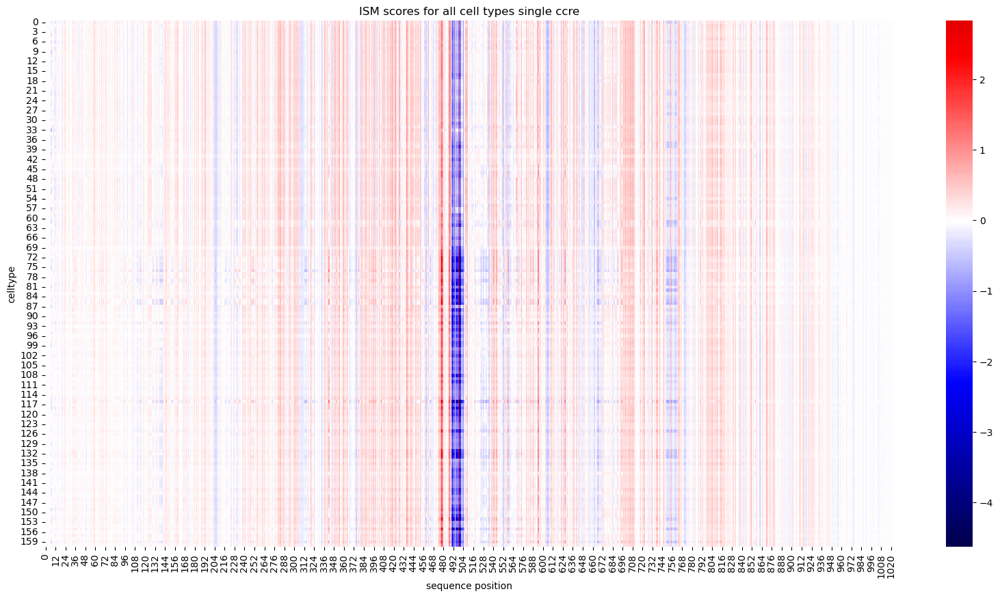

In [65]:
util_cts2.plot_all(ism1)

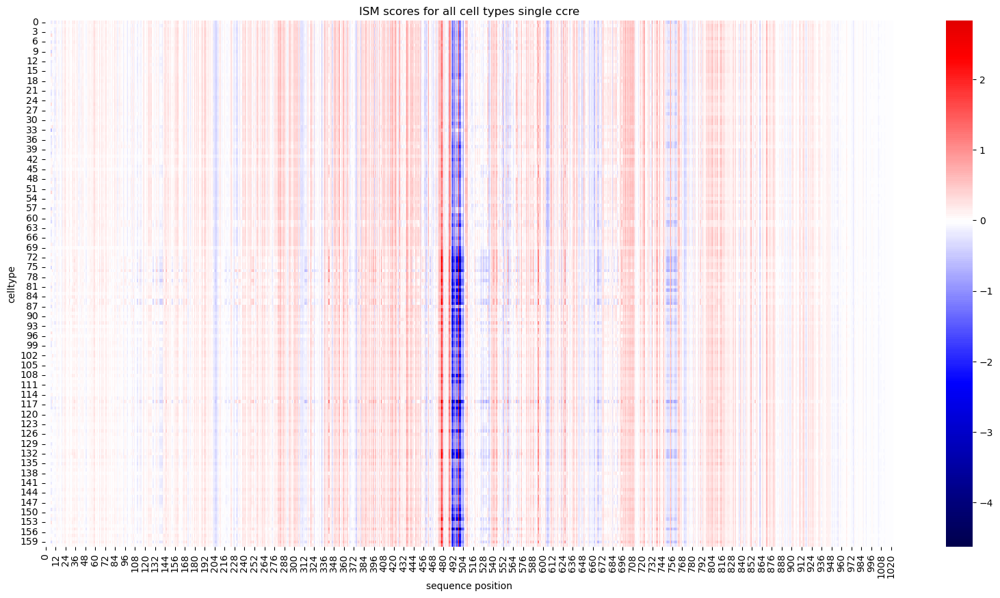

In [66]:
#and of the old one
util_cts2.plot_all(ism1_old)

In [67]:
#increase tolerance a bit
np.allclose(ism1, ism1_old, atol = 1e-4) #should be True, and it is

True

In [71]:
np.allclose(ism0, ism1, atol = 1) #even this is false, these are super far apart, I think it's just differences based on some randomness

False

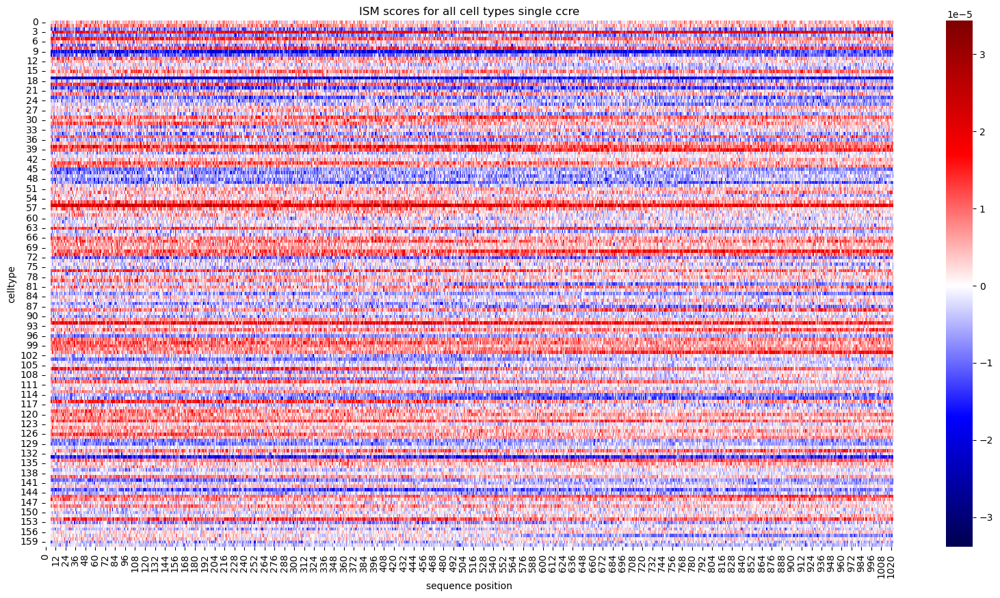

In [72]:
#and of the old one
util_cts2.plot_all(ism1_old-ism1) #see tiny differences

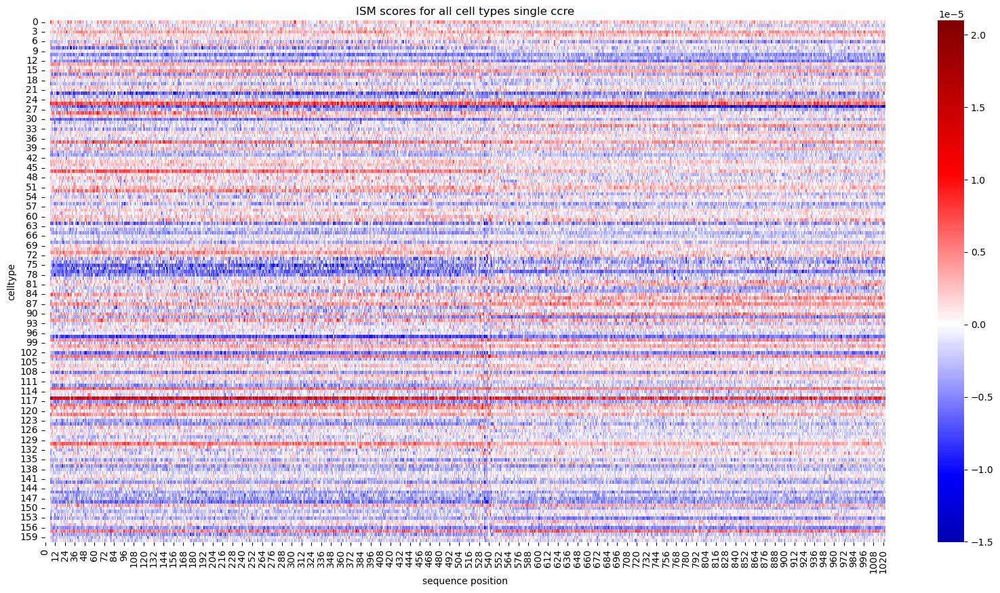

In [73]:
#and for 0
util_cts2.plot_all(ism0_old-ism0) #see tiny differences again

In [88]:
#finally test the allcelltypes model
util_cts3 = ISMUtils('DNase_allcelltypes',multitasking_path)

In [89]:
ism0 = util_cts3.calculate_ISM(0, cuda = True)


tensor(9)
tensor(9)


IndexError: index 1 is out of bounds for dimension 0 with size 1

In [83]:
ism0.shape

(4, 1023, 161)

In [82]:
ism0_old = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_allcelltypes0.npy')
np.allclose(ism0, ism0_old, atol = 1e-3) #should be True, and it is

False

In [86]:
#changed some stuff
ism0 = util_cts3.calculate_ISM(0, cuda = True, progress_bar=True)
ism0_old = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_allcelltypes0.npy')
np.allclose(ism0, ism0_old, atol = 1e-3) #should be True, and it is

  0%|          | 0/1023 [00:00<?, ?it/s]


ValueError: not enough values to unpack (expected 2, got 1)

In [92]:
#we'll debug later, let's check the original model again
util_cts2 = ISMUtils('DNase',cts_path2)
#now check it on the 99th ccre
ism99 = util_cts2.calculate_ISM(99, cuda = True, progress_bar=True)
ism99_old = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_99.npy')

100%|██████████| 1023/1023 [01:22<00:00, 12.45it/s]


In [93]:
#now let's compare
np.allclose(ism99, ism99_old, atol = 1e-5) #should be True, and it is, so this one seems to be working great! NEed to revisit the multitasking one, can manually go through that process

True

In [103]:
#let's test the last model
util_ctst = ISMUtils('DNase_ctst',ctst_path)
ism0 = util_ctst.calculate_ISM(0, cuda = True, progress_bar=True)

100%|██████████| 1024/1024 [01:15<00:00, 13.57it/s]


In [99]:
a,b=util_ctst.dataset[0]
print(a.shape,b.shape)

torch.Size([1024]) torch.Size([1])


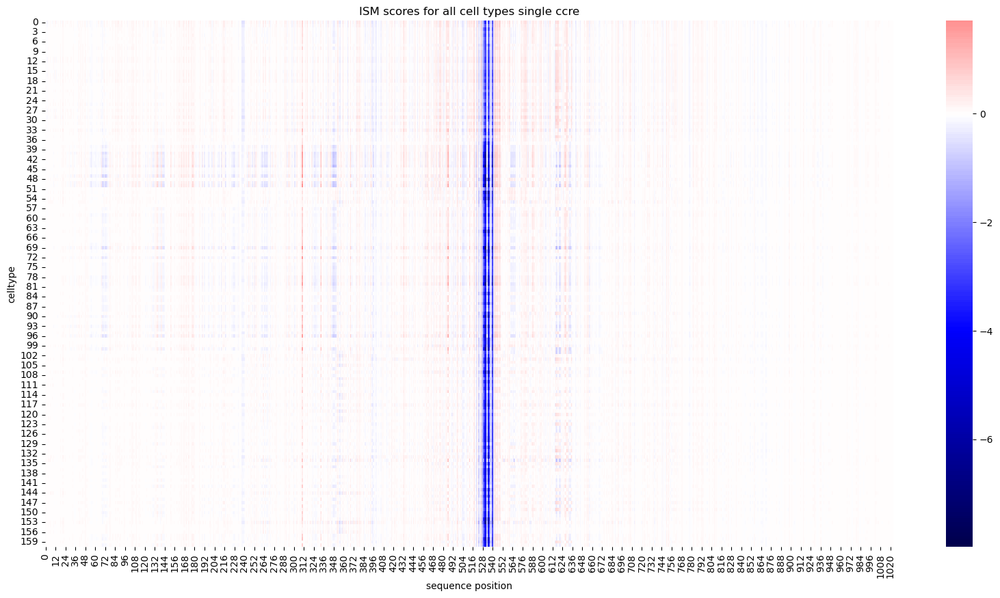

In [104]:
#now we can plot it to see if the results at all make any sense
util_ctst.plot_all(ism0) #very similar!! HAve to compare results and all, but liking this a lot!! And again it's just the ccre region for the most part!!

# testing the flipped logo plot

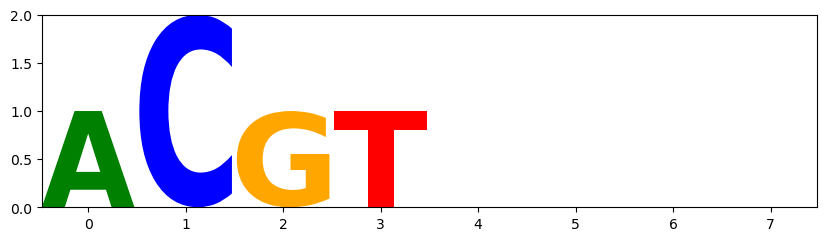

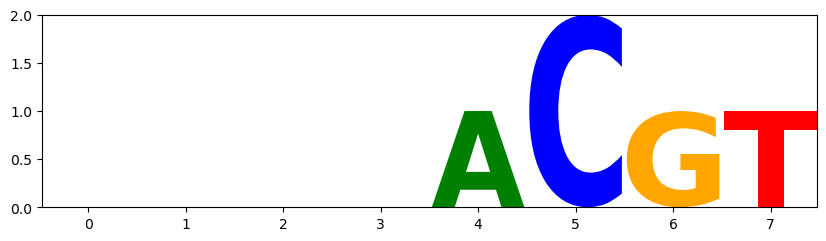

In [3]:
import logomaker
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
cut_seq = 'ACGTACGT'
logo_df_plus = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)
logo_df_minus = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)
heights = np.array([1,2,1,1,-1,-2,-1,-1])
for i, symbol in enumerate(cut_seq):
    if heights[i] > 0:
        logo_df_plus.loc[i, symbol] = np.abs(heights)[i]
    else:
        logo_df_minus.loc[i, symbol] = np.abs(heights)[i]

logo_plus = logomaker.Logo(logo_df_plus, color_scheme='classic')
logo_minus = logomaker.Logo(logo_df_minus, color_scheme='classic')

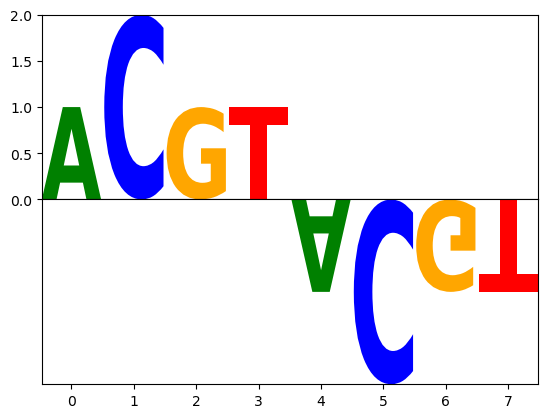

In [10]:
#chatgpt  had some great ideas, let's try it, where we do a subplot and then flip one side, so one for positive, one for negative
#likely a lot of work, but it could be fun to do!!
#here's what chatgpt says

# import matplotlib.pyplot as plt
# You might need to adjust limits and labeling to make the plots align neatly
fig, (ax_pos, ax_neg) = plt.subplots(2, 1, sharex=True)

logo_plus = logomaker.Logo(logo_df_plus, color_scheme='classic', ax=ax_pos)
logo_minus = logomaker.Logo(logo_df_minus, color_scheme='classic', ax=ax_neg)


# Generate the positive logo in ax_pos
# Generate the "negative" logo in ax_neg, remembering to flip the values to positive for plotting

#now plot the negative one
# logo_minus.draw(ax=ax_neg)

# Flip the negative values plot
ax_neg.invert_yaxis()
# ax_neg.invert_xaxis()

# Adjust spacing and remove the y-axis labels if needed
plt.subplots_adjust(hspace=0)  # Adjust space between plots
ax_pos.get_xaxis().set_visible(False)  # Hide the x-axis on the top plot if preferred
ax_neg.get_yaxis().set_visible(False)  # Hide the y-axis labels on the inverted plot for clarity

plt.show()


#what we would need to do is generate the datafram with positive and negative, then make one that is all positive and clamp negative values to be 0
#then the opposite for the negative one, and then we could easily do it like that. Let's plaly around and test it!!

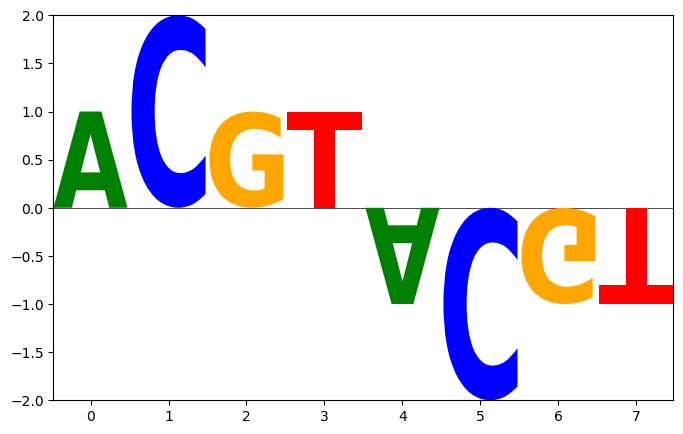

In [16]:
#wait, it seems that we can just use this flip_below command?
cut_seq = 'ACGTACGT'
logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)
fig,ax = plt.subplots(1,1, figsize = (8,5))
# logo_df_minus = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)
heights = np.array([1,2,1,1,-1,-2,-1,-1])
for i, symbol in enumerate(cut_seq):
    logo_df.loc[i, symbol] = heights[i]

logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below=True, ax = ax)

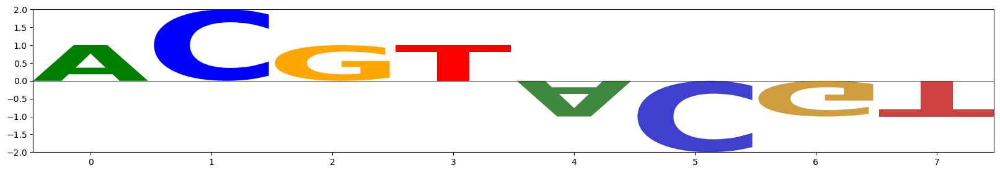

In [23]:
cut_seq = 'ACGTACGT'
logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)
fig,ax = plt.subplots(1,1, figsize = (20,3))
# logo_df_minus = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)
heights = np.array([1,2,1,1,-1,-2,-1,-1])
for i, symbol in enumerate(cut_seq):
    logo_df.loc[i, symbol] = heights[i]

logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below=True, ax = ax, fade_below=.25, shade_below=0.25)

In [5]:
logo_plus

In [ ]:
#now we have everything we need for analysis, we'll produce it for the next 

# showing results for all 4 models

In [1]:
#we have tons of model results! Now let's plot it for various cCREs, preferably ones that are enhanceers,, let's find some that are enhancers

#first plot the results of all 4 in a 2x2 scatter plot to see how well it does!
from shap_analysis.ism_utils import ISMUtils
multitasking_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-23/09-35-33-196632/checkpoints/381-val_loss=3.57483.ckpt'
cts_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-29/15-45-02-282170/checkpoints/last.ckpt'
cts_path2 = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-09/17-38-16-568113/checkpoints/last.ckpt' #this is again the 10% 100 epochs one
ctst_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-23/09-35-11-173861/checkpoints/last.ckpt'

#let's try the ctst path
util_cts = ISMUtils('DNase',cts_path, cfg = 'DNase_full.yaml')
util_cts2 = ISMUtils('DNase',cts_path2)
util_multitask = ISMUtils('DNase_allcelltypes',multitasking_path)
util_ctst = ISMUtils('DNase_ctst',ctst_path)

In [2]:
#let's first find the first DNase

#let's make it print the values that are dELS
for i in range(100):
    dtype = util_multitask.find_ccre_type(i).lower()
    if 'dels' in dtype or 'pels' in dtype: #use multitask, else would have to do find_ccre_type(i*161)
        print(i, dtype)

1 pels,ctcf-bound
5 dels
6 dels
9 pels,ctcf-bound
10 pels
11 pels,ctcf-bound
13 pels,ctcf-bound
14 pels,ctcf-bound
15 pels
16 pels
17 pels
18 pels,ctcf-bound
19 pels,ctcf-bound
21 dels
22 dels
23 dels,ctcf-bound
24 dels
25 dels
26 dels
27 dels
28 dels
29 dels
30 dels
31 dels
33 pels,ctcf-bound
35 dels,ctcf-bound
36 dels,ctcf-bound
37 pels,ctcf-bound
38 pels,ctcf-bound
40 pels,ctcf-bound
41 pels,ctcf-bound
42 pels,ctcf-bound
43 dels,ctcf-bound
44 pels,ctcf-bound
46 pels
47 pels,ctcf-bound
48 pels,ctcf-bound
49 pels
50 dels,ctcf-bound
51 pels,ctcf-bound
52 pels,ctcf-bound
53 pels,ctcf-bound
54 pels,ctcf-bound
55 pels,ctcf-bound
56 pels,ctcf-bound
58 pels,ctcf-bound
59 pels,ctcf-bound
60 pels,ctcf-bound
61 pels,ctcf-bound
63 pels,ctcf-bound
64 dels,ctcf-bound
65 dels,ctcf-bound
66 dels,ctcf-bound
67 dels,ctcf-bound
68 dels
69 dels
70 dels
71 dels,ctcf-bound
72 dels
73 dels,ctcf-bound
74 dels
75 dels,ctcf-bound
76 dels,ctcf-bound
77 dels,ctcf-bound
78 dels,ctcf-bound
79 dels,ctcf-bound
80 

predicted output mean: 0.0704856493643352, actual output mean: 0.009346853108694835
predicted output mean: 0.22841852033360405, actual output mean: 0.009346853108694835
predicted output mean: 0.20788489282131195, actual output mean: 0.009346856735646725
predicted output mean: 0.7203189378968723, actual output mean: 0.009346853108694835


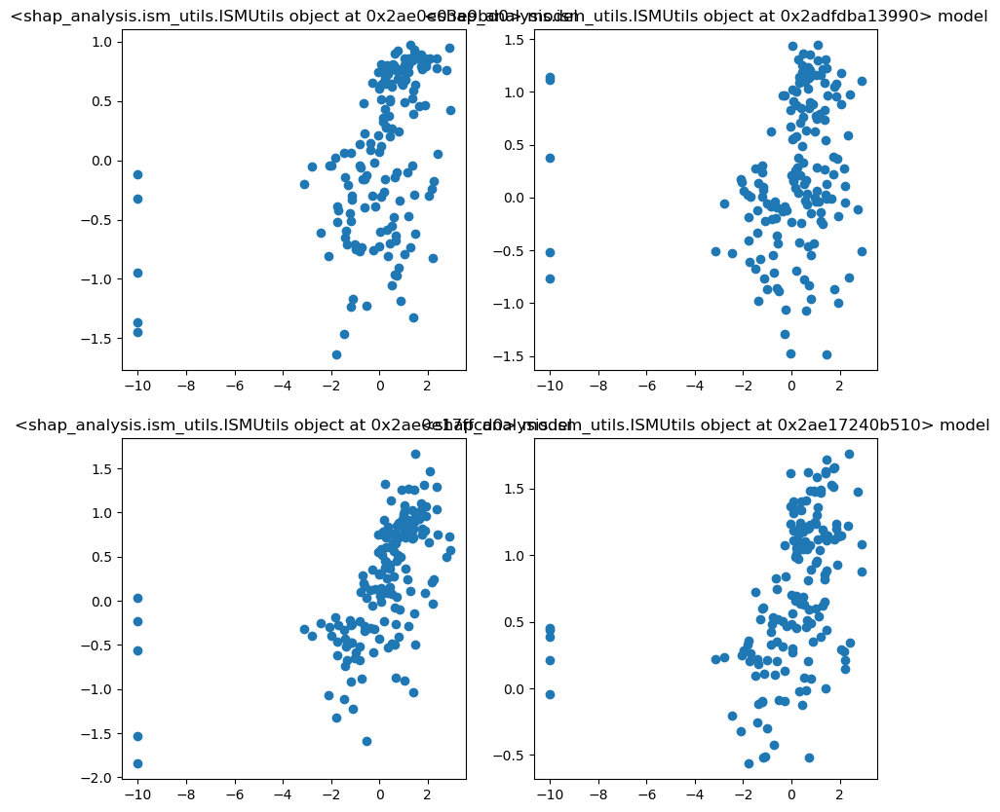

In [3]:
#now let's plot the results of all 4 for these ccres, and find one where at least some predict well!
#have the output all function for each class that will return the output for all the cell types of that ccre!
utils_list = [util_cts, util_cts2, util_multitask, util_ctst]
#let's start with a basic one from that list above
idx = 10 #just a random one we chose from above
#make a 2x2 subplot
import matplotlib.pyplot as plt
fig, ax = plt.subplots(2,2, figsize = (10,10))
ax_flat = ax.flatten()
for j,i in enumerate(utils_list):
    target,out = i.output_all(idx)
    # now do a scatter plot based on the index in the subplot
    ax_flat[j].scatter(target, out)
    ax_flat[j].set_title(f'{i} model')


predicted output mean: 0.20741005417723093, actual output mean: -0.593871305146405
predicted output mean: -0.05706850115371787, actual output mean: -0.593871305146405
predicted output mean: -0.2425754815340042, actual output mean: -0.5938712954521179
predicted output mean: 0.09807959053468723, actual output mean: -0.593871305146405


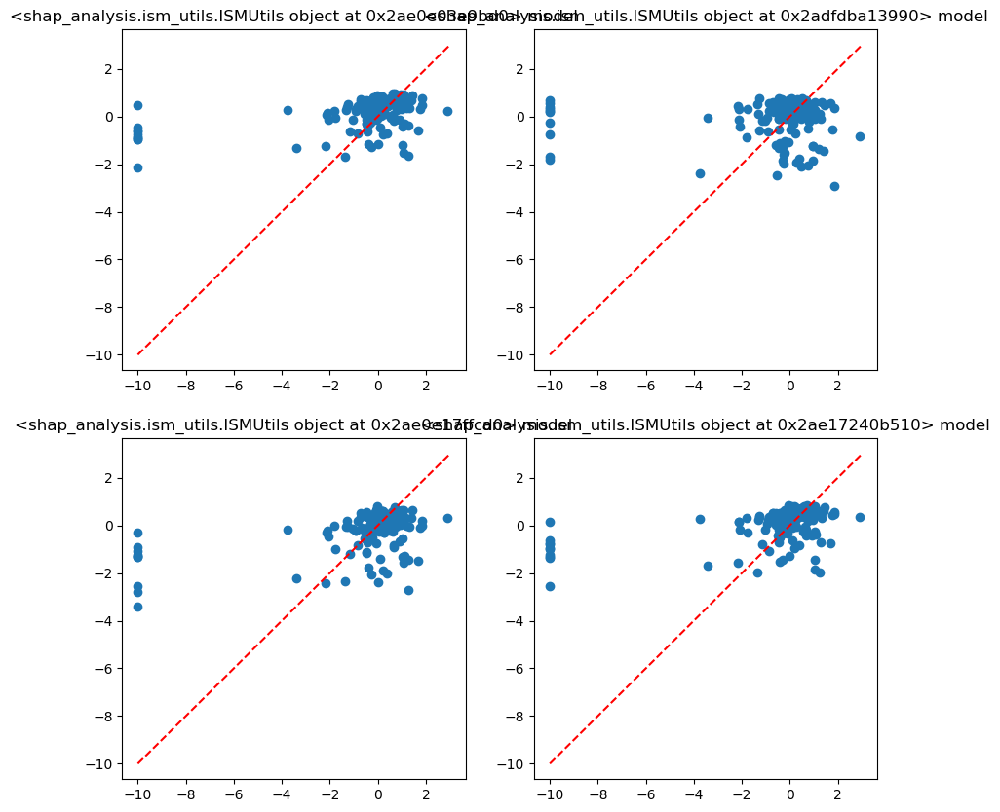

In [7]:
#set idx to 15 and replot
idx = 15 #just a random one we chose from above
fig, ax = plt.subplots(2,2, figsize = (10,10))
ax_flat = ax.flatten()
for j,i in enumerate(utils_list):
    target,out = i.output_all(idx)
    # now do a scatter plot based on the index in the subplot
    ax_flat[j].scatter(target, out)
    #add the 1,1 line
    ax_flat[j].plot([-10,3],[-10,3], 'r--')
    ax_flat[j].set_title(f'{i} model')


predicted output mean: -0.007276065046002406, actual output mean: -0.9640603773180187
predicted output mean: -0.015017761576990163, actual output mean: -0.9640603773180187
predicted output mean: 0.09830623865127563, actual output mean: -0.9640604257583618
predicted output mean: 0.100003658825682, actual output mean: -0.9640603773180187


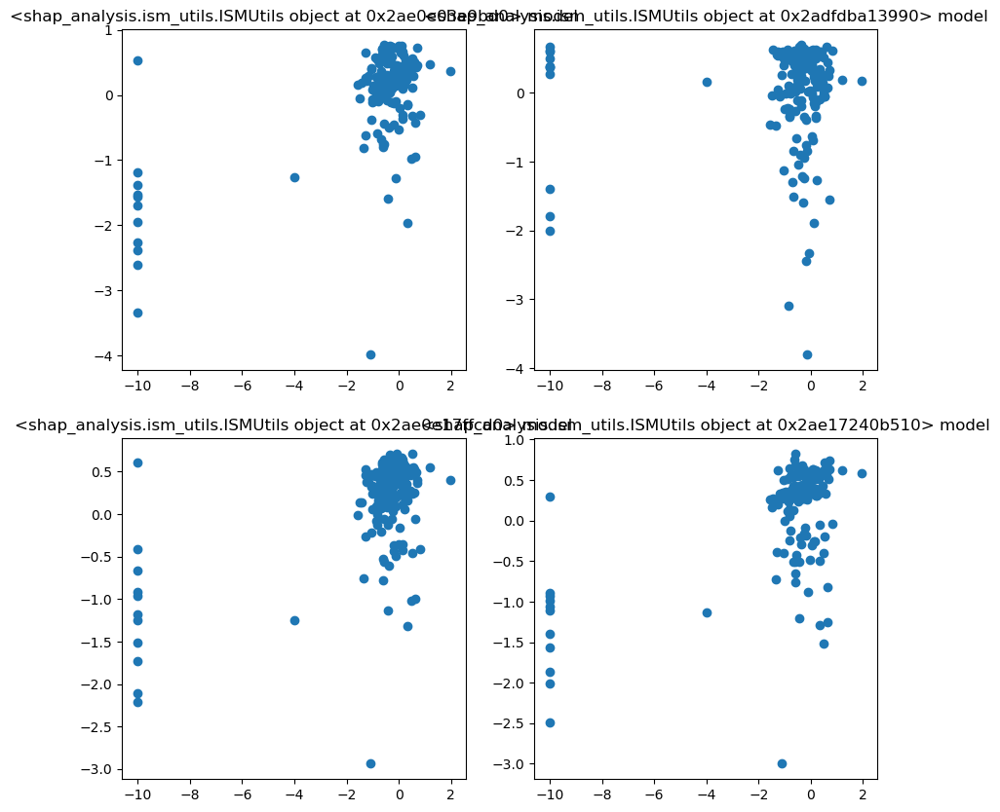

In [5]:
#let's try it on another one
idx = 30 #just a random one we chose from above
fig, ax = plt.subplots(2,2, figsize = (10,10))
ax_flat = ax.flatten()
for j,i in enumerate(utils_list):
    target,out = i.output_all(idx)
    # now do a scatter plot based on the index in the subplot
    ax_flat[j].scatter(target, out)
    ax_flat[j].set_title(f'{i} model')


In [9]:
#load in all the results
import numpy as np
ism15_cts2 = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_15.npy')
ism15_multitask = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_allcelltypes15.npy')
ism15_cts = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_fulltrain15.npy')
ism15_ctst = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_ctst15.npy')
print(ism15_cts2.shape, ism15_multitask.shape, ism15_cts.shape, ism15_ctst.shape)

(4, 1023, 161) (4, 1023, 161) (4, 1023, 161) (4, 1024, 161)


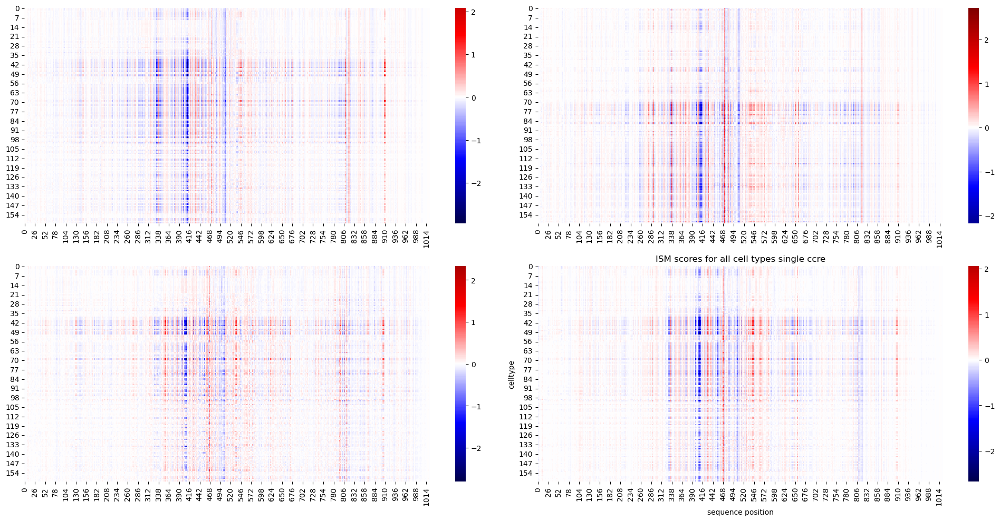

In [11]:
#now we can produce the overall summary plots for the 4 model types
#let's stick with 15, this is idx 15
#make a 2x2 subplot
import seaborn as sns
results_list = [ism15_cts, ism15_cts2, ism15_multitask, ism15_ctst]
fig, ax = plt.subplots(2,2, figsize = (20,10))
for j,i in enumerate(results_list):
    #now we can plot the results
    sns.heatmap(i.sum(axis = 0).T, cmap = 'seismic', center = 0, ax = ax.flatten()[j])
    plt.ylabel('celltype')
    plt.xlabel('sequence position')
    plt.title('ISM scores for all cell types single ccre')
fig.tight_layout()

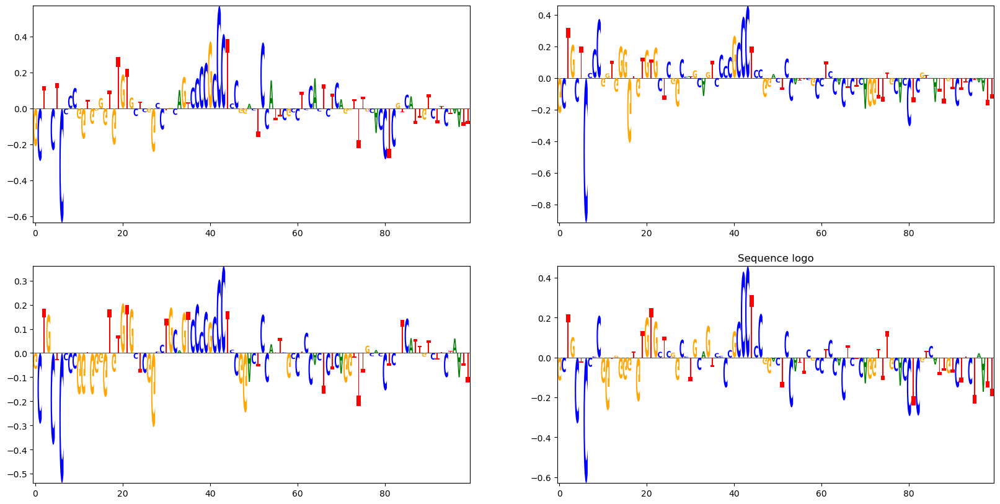

In [25]:
#same for logo plots
import pandas as pd
import logomaker
fig, ax = plt.subplots(2,2, figsize = (20,10))
ccre = 15
tempccre = ccre
for j,i in enumerate(utils_list):
    #now we can plot the results
    startend = (1023//2-50,1023//2+50)
    if i.mtype == 'DNase' or i.mtype == 'DNase_ctst':
        tempccre = 161*ccre
    else:
        tempccre = ccre
    a,b = i.dataset[tempccre]
    seq=i.dataset.tokenizer.decode(a[1:]) #hack to deal with 
    if startend is None and i.mtype == 'DNase':
        start = i.middle-50+4
        end = i.middle+50+4
    elif startend is None and i.mtype == 'DNase_allcelltypes':
        start = i.middle-50
        end = i.middle+50
    elif i.mtype == 'DNase': #if specify it, add 4 to the dnase, just so aligns with the multitasking model
        start = startend[0]+4
        end = startend[1]+4
    elif i.mtype == 'DNase_ctst':
        start = startend[0]+1
        end = startend[1]+1
    else:
        start = startend[0]
        end = startend[1]

    #now we can define cut_seq
    cut_seq = seq[start:end]
    heights = i.default_heights(results_list[j])

    #now we define cut heights
    heights = heights[start:end]
    if True:
        heights = -heights
    logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)

    # Fill the DataFrame with heights, converting heights to float if necessary
    for i, symbol in enumerate(cut_seq):
        logo_df.loc[i, symbol] = heights[i]

    # Generate the sequence logo
    # fig, ax = 
    # fig.set_size_inches(20, 3)  # Set the desired width and height here        
    logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below = True, ax = ax.flatten()[j])
    plt.title('Sequence logo')
#we see that our ctst is one off, figure that out and be pro af!!

In [21]:
i.dataset.tokenizer._vocab_str_to_int

{'[CLS]': 0,
 '[SEP]': 1,
 '[BOS]': 2,
 '[MASK]': 3,
 '[PAD]': 4,
 '[RESERVED]': 5,
 '[UNK]': 6,
 'A': 7,
 'C': 8,
 'G': 9,
 'T': 10,
 'N': 11}

# repeating the process

In [1]:
#now that we have the approach to do it, can do it and label it properly
#we have tons of model results! Now let's plot it for various cCREs, preferably ones that are enhanceers,, let's find some that are enhancers

#first plot the results of all 4 in a 2x2 scatter plot to see how well it does!
from shap_analysis.ism_utils import ISMUtils
multitasking_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-23/09-35-33-196632/checkpoints/381-val_loss=3.57483.ckpt'
cts_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-29/15-45-02-282170/checkpoints/last.ckpt'
cts_path2 = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-09/17-38-16-568113/checkpoints/last.ckpt' #this is again the 10% 100 epochs one
ctst_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-23/09-35-11-173861/checkpoints/last.ckpt'

#let's try the ctst path
util_cts = ISMUtils('DNase',cts_path, cfg = 'DNase_full.yaml')
util_cts2 = ISMUtils('DNase',cts_path2)
util_multitask = ISMUtils('DNase_allcelltypes',multitasking_path)
util_ctst = ISMUtils('DNase_ctst',ctst_path)

predicted output mean: 0.6559129560667073, actual output mean: -4.677388072467947
predicted output mean: 1.1246283852628298, actual output mean: -4.677388072467947
predicted output mean: -0.5631594061851501, actual output mean: -4.677387714385986
predicted output mean: 1.1423699253452768, actual output mean: -4.677388072467947


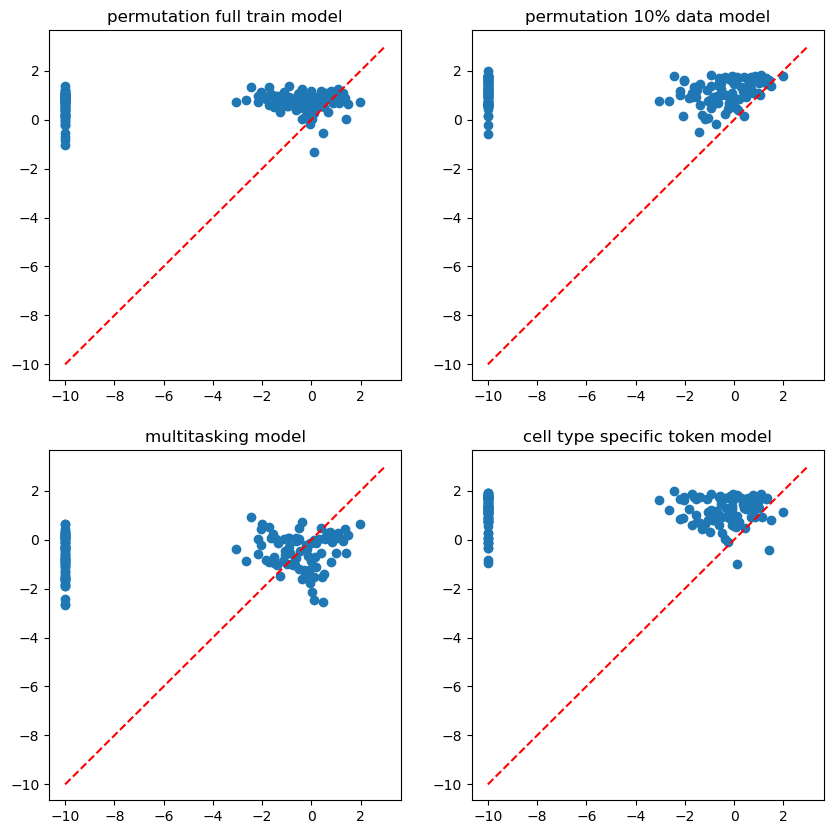

In [2]:
#set idx to 15 and replot
import matplotlib.pyplot as plt
utils_list = [util_cts, util_cts2, util_multitask, util_ctst]
name_list = ['permutation full train', 'permutation 10% data', 'multitasking', 'cell type specific token']
idx = 0 #just a random one we chose from above
fig, ax = plt.subplots(2,2, figsize = (10,10))
ax_flat = ax.flatten()
for j,i in enumerate(utils_list):
    target,out = i.output_all(idx)
    # now do a scatter plot based on the index in the subplot
    ax_flat[j].scatter(target, out)
    #add the 1,1 line
    ax_flat[j].plot([-10,3],[-10,3], 'r--')
    ax_flat[j].set_title(f'{name_list[j]} model')


predicted output mean: 0.20740994616695071, actual output mean: -0.593871305146405
predicted output mean: -0.05706887420336282, actual output mean: -0.593871305146405
predicted output mean: -0.2425762414932251, actual output mean: -0.5938712954521179
predicted output mean: 0.09807985457331404, actual output mean: -0.593871305146405


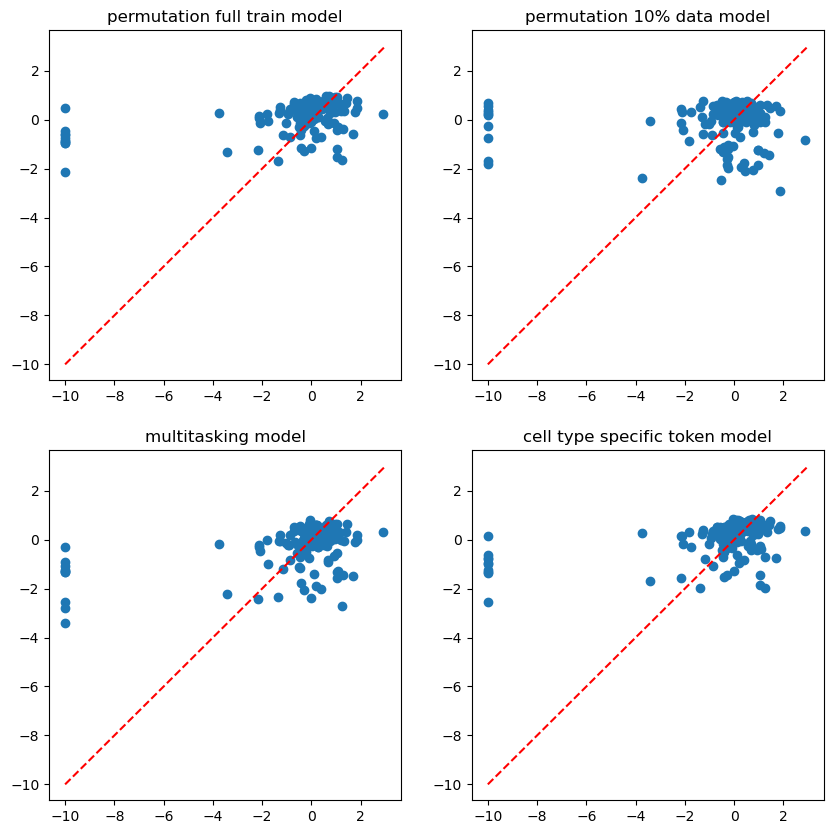

In [4]:
#set idx to 15 and replot
idx = 15 #just a random one we chose from above
fig, ax = plt.subplots(2,2, figsize = (10,10))
ax_flat = ax.flatten()
for j,i in enumerate(utils_list):
    target,out = i.output_all(idx)
    # now do a scatter plot based on the index in the subplot
    ax_flat[j].scatter(target, out)
    #add the 1,1 line
    ax_flat[j].plot([-10,3],[-10,3], 'r--')
    ax_flat[j].set_title(f'{name_list[j]} model')

In [6]:
#load in all the results
import numpy as np
ism15_cts2 = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_15.npy')
ism15_multitask = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_allcelltypes15.npy')
ism15_cts = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_fulltrain15.npy')
ism15_ctst = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_ctst15.npy')
print(ism15_cts2.shape, ism15_multitask.shape, ism15_cts.shape, ism15_ctst.shape)
import seaborn as sns
results_list = [ism15_cts, ism15_cts2, ism15_multitask, ism15_ctst]

(4, 1023, 161) (4, 1023, 161) (4, 1023, 161) (4, 1024, 161)


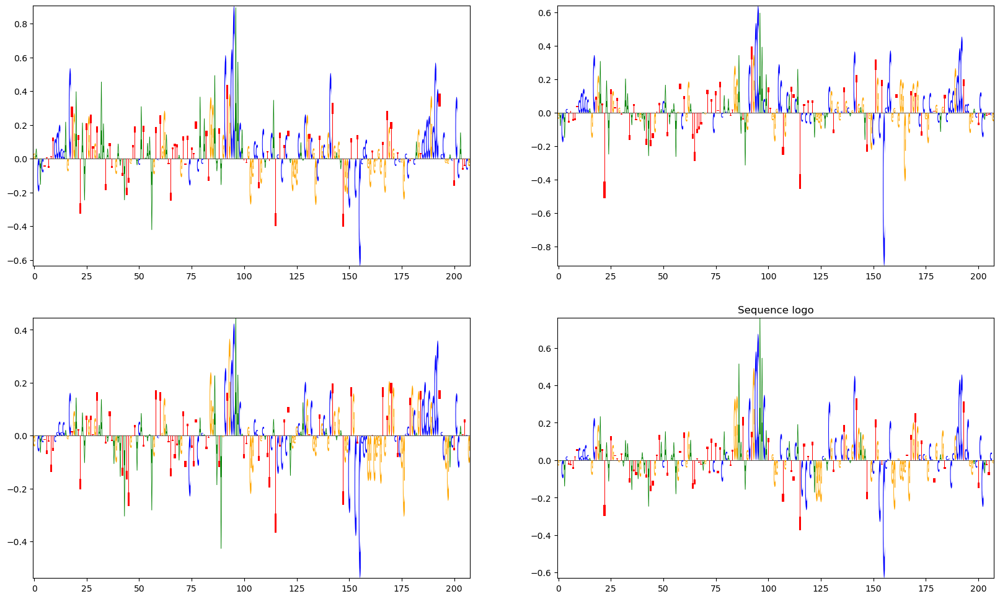

In [7]:
#same for logo plots
import pandas as pd
import logomaker
fig, ax = plt.subplots(2,2, figsize = (20,12))
ccre = 15
tempccre = ccre
for j,i in enumerate(utils_list):
    #now we can plot the results
    startend = (312,520)
    if i.mtype == 'DNase' or i.mtype == 'DNase_ctst':
        tempccre = 161*ccre
    else:
        tempccre = ccre
    a,b = i.dataset[tempccre]
    seq=i.dataset.tokenizer.decode(a[1:]) #hack to deal with 
    if startend is None and i.mtype == 'DNase':
        start = i.middle-50+4
        end = i.middle+50+4
    elif startend is None and i.mtype == 'DNase_allcelltypes':
        start = i.middle-50
        end = i.middle+50
    elif i.mtype == 'DNase': #if specify it, add 4 to the dnase, just so aligns with the multitasking model
        start = startend[0]+4
        end = startend[1]+4
    elif i.mtype == 'DNase_ctst':
        start = startend[0]+1
        end = startend[1]+1
    else:
        start = startend[0]
        end = startend[1]

    #now we can define cut_seq
    cut_seq = seq[start:end]
    heights = i.default_heights(results_list[j])

    #now we define cut heights
    heights = heights[start:end]
    if True:
        heights = -heights
    logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)

    # Fill the DataFrame with heights, converting heights to float if necessary
    for i, symbol in enumerate(cut_seq):
        logo_df.loc[i, symbol] = heights[i]

    # Generate the sequence logo
    # fig, ax = 
    # fig.set_size_inches(20, 3)  # Set the desired width and height here        
    logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below = True, ax = ax.flatten()[j])
    plt.title('Sequence logo')
#we see that our ctst is one off, figure that out and be pro af!!

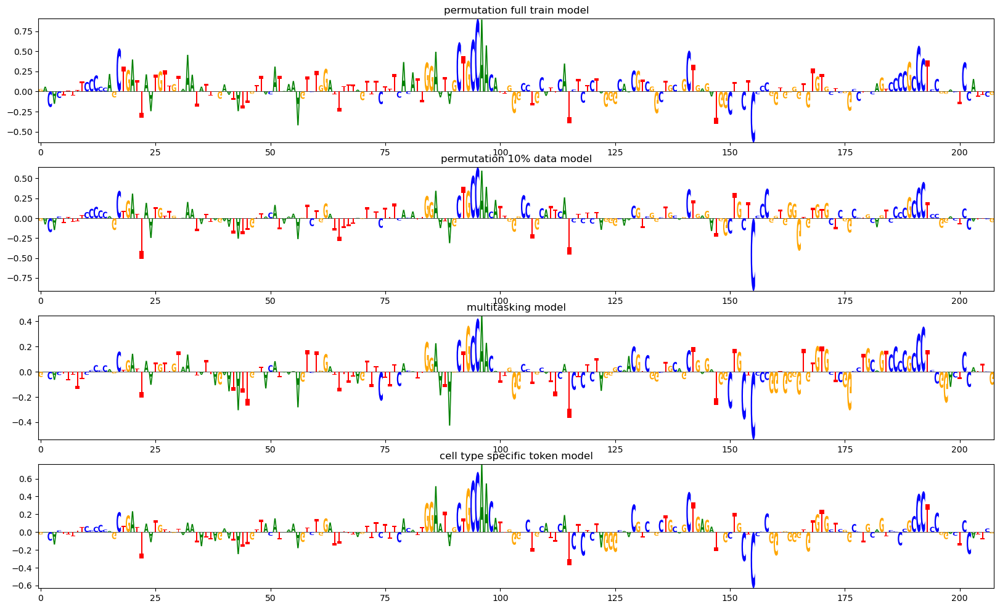

In [9]:
#same for logo plots
import pandas as pd
import logomaker
fig, ax = plt.subplots(4,1, figsize = (20,12))
ccre = 15
tempccre = ccre
for j,i in enumerate(utils_list):
    #now we can plot the results
    startend = (312,520)
    if i.mtype == 'DNase' or i.mtype == 'DNase_ctst':
        tempccre = 161*ccre
    else:
        tempccre = ccre
    a,b = i.dataset[tempccre]
    seq=i.dataset.tokenizer.decode(a[1:]) #hack to deal with 
    if startend is None and i.mtype == 'DNase':
        start = i.middle-50+4
        end = i.middle+50+4
    elif startend is None and i.mtype == 'DNase_allcelltypes':
        start = i.middle-50
        end = i.middle+50
    elif i.mtype == 'DNase': #if specify it, add 4 to the dnase, just so aligns with the multitasking model
        start = startend[0]+4
        end = startend[1]+4
    elif i.mtype == 'DNase_ctst':
        start = startend[0]+1
        end = startend[1]+1
    else:
        start = startend[0]
        end = startend[1]

    #now we can define cut_seq
    cut_seq = seq[start:end]
    heights = i.default_heights(results_list[j])

    #now we define cut heights
    heights = heights[start:end]
    if True:
        heights = -heights
    logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)

    # Fill the DataFrame with heights, converting heights to float if necessary
    for i, symbol in enumerate(cut_seq):
        logo_df.loc[i, symbol] = heights[i]

    # Generate the sequence logo
    # fig, ax = 
    # fig.set_size_inches(20, 3)  # Set the desired width and height here        
    logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below = True, ax = ax.flatten()[j])
    #now set the title
    ax.flatten()[j].set_title(f'{name_list[j]} model')
#we see that our ctst is one off, figure that out and be pro af!!

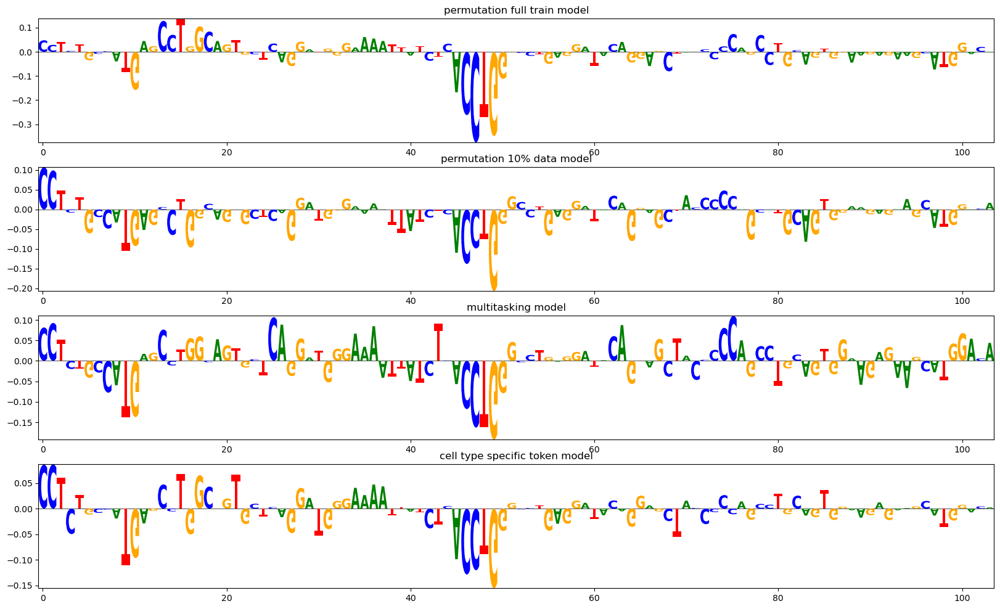

In [10]:
#same for logo plots
import pandas as pd
import logomaker
fig, ax = plt.subplots(4,1, figsize = (20,12))
ccre = 15
tempccre = ccre
for j,i in enumerate(utils_list):
    #now we can plot the results
    startend = (858,962)
    if i.mtype == 'DNase' or i.mtype == 'DNase_ctst':
        tempccre = 161*ccre
    else:
        tempccre = ccre
    a,b = i.dataset[tempccre]
    seq=i.dataset.tokenizer.decode(a[1:]) #hack to deal with 
    if startend is None and i.mtype == 'DNase':
        start = i.middle-50+4
        end = i.middle+50+4
    elif startend is None and i.mtype == 'DNase_allcelltypes':
        start = i.middle-50
        end = i.middle+50
    elif i.mtype == 'DNase': #if specify it, add 4 to the dnase, just so aligns with the multitasking model
        start = startend[0]+4
        end = startend[1]+4
    elif i.mtype == 'DNase_ctst':
        start = startend[0]+1
        end = startend[1]+1
    else:
        start = startend[0]
        end = startend[1]

    #now we can define cut_seq
    cut_seq = seq[start:end]
    heights = i.default_heights(results_list[j])

    #now we define cut heights
    heights = heights[start:end]
    if True:
        heights = -heights
    logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)

    # Fill the DataFrame with heights, converting heights to float if necessary
    for i, symbol in enumerate(cut_seq):
        logo_df.loc[i, symbol] = heights[i]

    # Generate the sequence logo
    # fig, ax = 
    # fig.set_size_inches(20, 3)  # Set the desired width and height here        
    logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below = True, ax = ax.flatten()[j])
    #now set the title
    ax.flatten()[j].set_title(f'{name_list[j]} model')
#we see that our ctst is one off, figure that out
#it's because we cut by 1, let's just not add 1 and we'll be good!

# functions for ISM utils

create functions that can go in ism utils to do the multiple logo plots and also the multiple ism plot  
they can go in  ism utils as functions, the input is things like the classes as a list, and adapts the plots  
for ism also only 1 colorbar to the right of all of them, and then an accessibility plot for each one as well, will be a tough plot but very worth it  
We can also make it so that the start and end values are plotted on the thing.  
Also, for the AGT logo plot, we can make it so that it doesn't show just 0 to 100 but rather is the actual start and end points and a bunch of intermediate ones

In [12]:
#let's start by making the logo function, as it will be easy
#same for logo plots
def multi_logo(utils_list,title_list, ccre):
    fig, ax = plt.subplots(4,1, figsize = (20,len(utils_list)*3))
    # ccre = 15
    tempccre = ccre
    for j,i in enumerate(utils_list):
        startend = (858,962)
        if i.mtype == 'DNase' or i.mtype == 'DNase_ctst':
            tempccre = 161*ccre
        else:
            tempccre = ccre
        a,b = i.dataset[tempccre]
        #now we will check to see if it's none, if so we will use the middle
        if startend is None:
            start = i.middle-50
            end = i.middle+50
        else:
            start = startend[0]
            end = startend[1]
        
        #now we can adjust the start and end
        if i.mtype == 'DNase': #if specify it, add 4 to the dnase, just so aligns with the multitasking model
            start = start+4
            end = end+4
        # elif i.mtype == 'DNase_ctst':
        #     start = start+1
        #     end = end+1

        try:
            seq=i.dataset.tokenizer.decode(a)
        except:
            seq=i.dataset.tokenizer.decode(a[1:]) #hack to deal with DNase

        #now we can define cut_seq
        cut_seq = seq[start:end]
        heights = i.default_heights(results_list[j])

        #now we define cut heights
        heights = heights[start:end]
        if True:
            heights = -heights
        logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)

        # Fill the DataFrame with heights, converting heights to float if necessary
        for i, symbol in enumerate(cut_seq):
            logo_df.loc[i, symbol] = heights[i]

        # Generate the sequence logo
        # fig, ax = 
        # fig.set_size_inches(20, 3)  # Set the desired width and height here        
        logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below = True, ax = ax.flatten()[j])
        #now set the title
        ax.flatten()[j].set_title(f'{name_list[j]} model')
    #we see that our ctst is one off, figure that out and be pro af!!

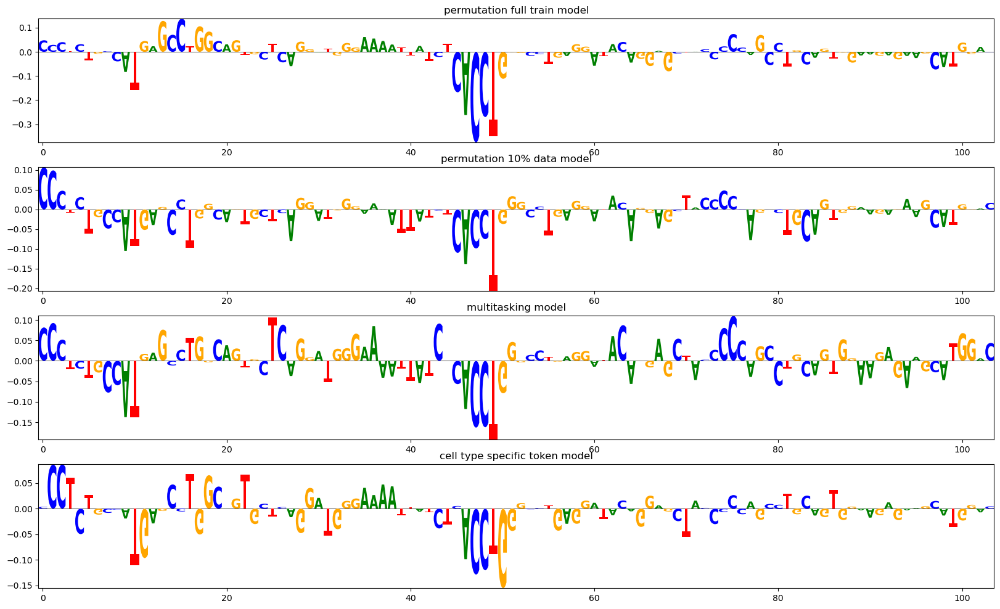

In [13]:
multi_logo(utils_list,name_list,15)

(<Figure size 2000x1200 with 4 Axes>,
 array([<Axes: title={'center': 'permutation full train model'}>,
        <Axes: title={'center': 'permutation 10% data model'}>,
        <Axes: title={'center': 'multitasking model'}>,
        <Axes: title={'center': 'cell type specific token model'}>],
       dtype=object))

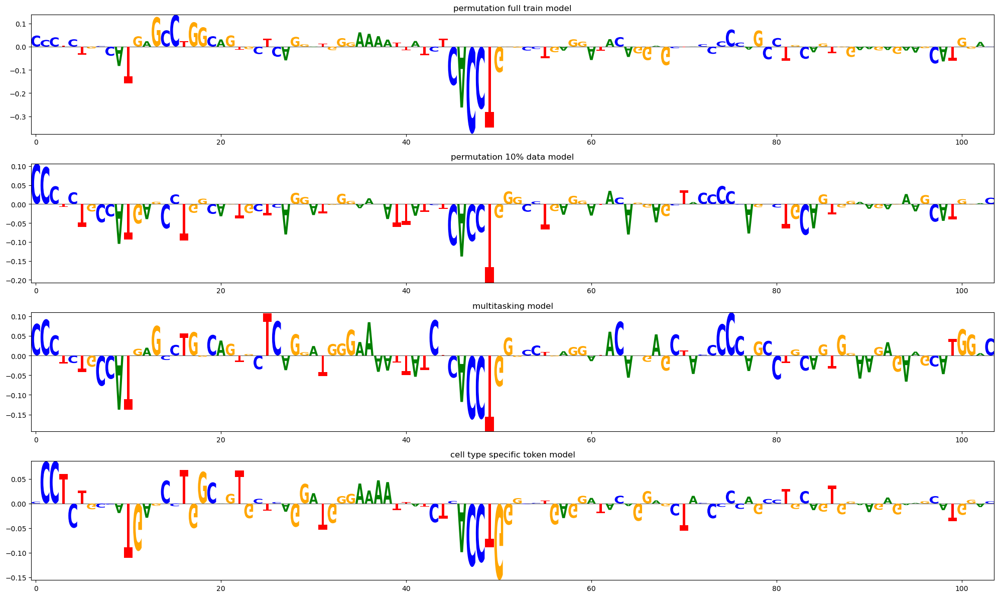

In [16]:
#and make it pretty
def multi_logo(utils_list,title_list, ccre, startend=None, heights_list = None):
    # utils list should be a list of the ISMUtils class
    # title list should be a list of the titles you want
    # ccre is the ccre number of that split
    # startend is the start and end of the sequence, if none, will use the middle 100
    # heights list is the list of heights, if none, will use the default heights which is just the mean over all celltypes of the ISM scores
    fig, ax = plt.subplots(len(utils_list),1, figsize = (20,len(utils_list)*3))
    tempccre = ccre
    for j,i in enumerate(utils_list):
        if i.mtype == 'DNase' or i.mtype == 'DNase_ctst':
            tempccre = 161*ccre
        else:
            tempccre = ccre
        a,b = i.dataset[tempccre]

        #now we will check to see if it's none, if so we will use the middle
        if startend is None:
            start = i.middle-50
            end = i.middle+50
        else:
            start = startend[0]
            end = startend[1]
        
        #now we can adjust the start and end
        if i.mtype == 'DNase': #if specify it, add 4 to the dnase, just so aligns with the multitasking model
            start = start+4
            end = end+4
        try:
            seq=i.dataset.tokenizer.decode(a)
        except:
            seq=i.dataset.tokenizer.decode(a[1:]) #hack to deal with DNase

        #now we can define cut_seq
        cut_seq = seq[start:end]
        if heights_list is None:
            heights = i.default_heights(results_list[j])
        else:
            heights = heights_list[j]

        #now we define cut heights
        heights = heights[start:end]
        if True:
            heights = -heights
        logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)

        # Fill the DataFrame with heights, converting heights to float if necessary
        for i, symbol in enumerate(cut_seq):
            logo_df.loc[i, symbol] = heights[i]

        # Generate the sequence logo
        logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below = True, ax = ax.flatten()[j])
        #now set the title
        ax.flatten()[j].set_title(f'{title_list[j]} model')
    plt.tight_layout()
    return fig, ax

multi_logo(utils_list,name_list,15, (858,962))

(<Figure size 2000x600 with 2 Axes>,
 array([<Axes: title={'center': 'permutation full train model'}>,
        <Axes: title={'center': 'permutation 10% data model'}>],
       dtype=object))

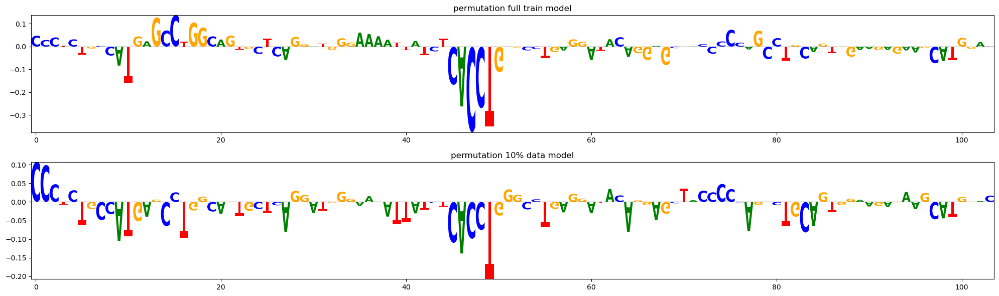

In [17]:
multi_logo(utils_list[:2],name_list,15, (858,962)) #works like expected!!

# and now fixing the other plot

Also do clustering for the cell type specific model, and make it the same clustering done on all of them

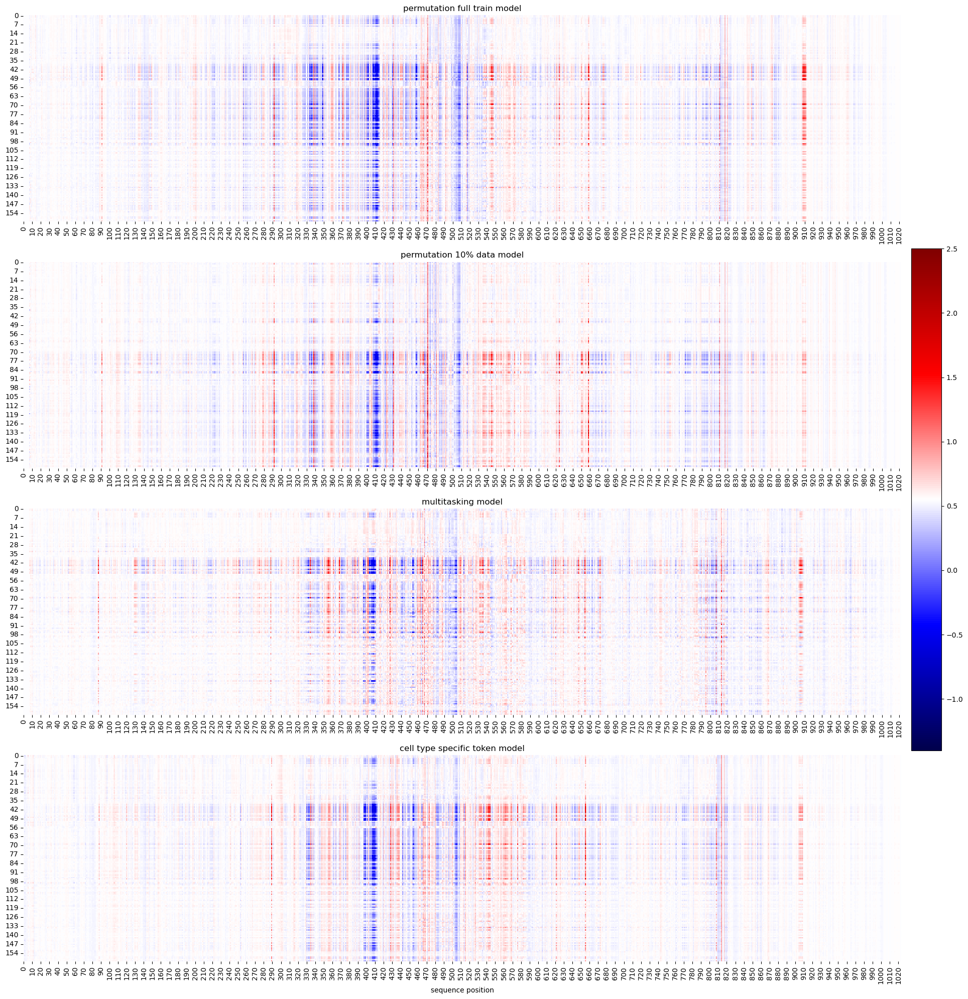

In [22]:
#now we can produce the overall summary plots for the 4 model types
#let's stick with 15, this is idx 15
#make a 2x2 subplot
import seaborn as sns
results_list = [ism15_cts, ism15_cts2, ism15_multitask, ism15_ctst]
fig, ax = plt.subplots(4,1, figsize = (20,20))
global_min = min([i.min() for i in results_list])
global_max = max([i.max() for i in results_list])
for j,i in enumerate(results_list):
    #now we can plot the results
    sns.heatmap(i.sum(axis = 0).T, cmap = 'seismic', center = 0, ax = ax.flatten()[j], cbar = False, vmin = global_min, vmax = global_max)
    # plt.ylabel('celltype')
    plt.xlabel('sequence position')
    #now set title
    ax.flatten()[j].set_title(f'{name_list[j]} model')
fig.tight_layout()
fig.subplots_adjust(right=0.9)
cbar_ax = fig.add_axes([0.91, 0.25, 0.03, 0.5])  # Adjust the dimensions as needed
sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max))
fig.colorbar(sm, cax=cbar_ax)


In [24]:
true_values = util_multitask.dataset[ccre][1]
true_values.shape

torch.Size([161])

In [ ]:
#now let's add in the true values for accessability

fig, ax = plt.subplots(4,1, figsize = (20,20))
global_min = min([i.min() for i in results_list])
global_max = max([i.max() for i in results_list])
for j,i in enumerate(results_list):
    #first we will calculate the true values
    true_values = util_multitask.dataset[ccre][1]
    #now we can plot the results
    sns.heatmap(i.sum(axis = 0).T, cmap = 'seismic', center = 0, ax = ax.flatten()[j], cbar = False, vmin = global_min, vmax = global_max)
    plt.xlabel('sequence position')
    ax.flatten()[j].set_title(f'{name_list[j]} model')
fig.tight_layout()
fig.subplots_adjust(right=0.9)
cbar_ax = fig.add_axes([0.91, 0.25, 0.03, 0.5])  # Adjust the dimensions as needed
sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max))
fig.colorbar(sm, cax=cbar_ax)

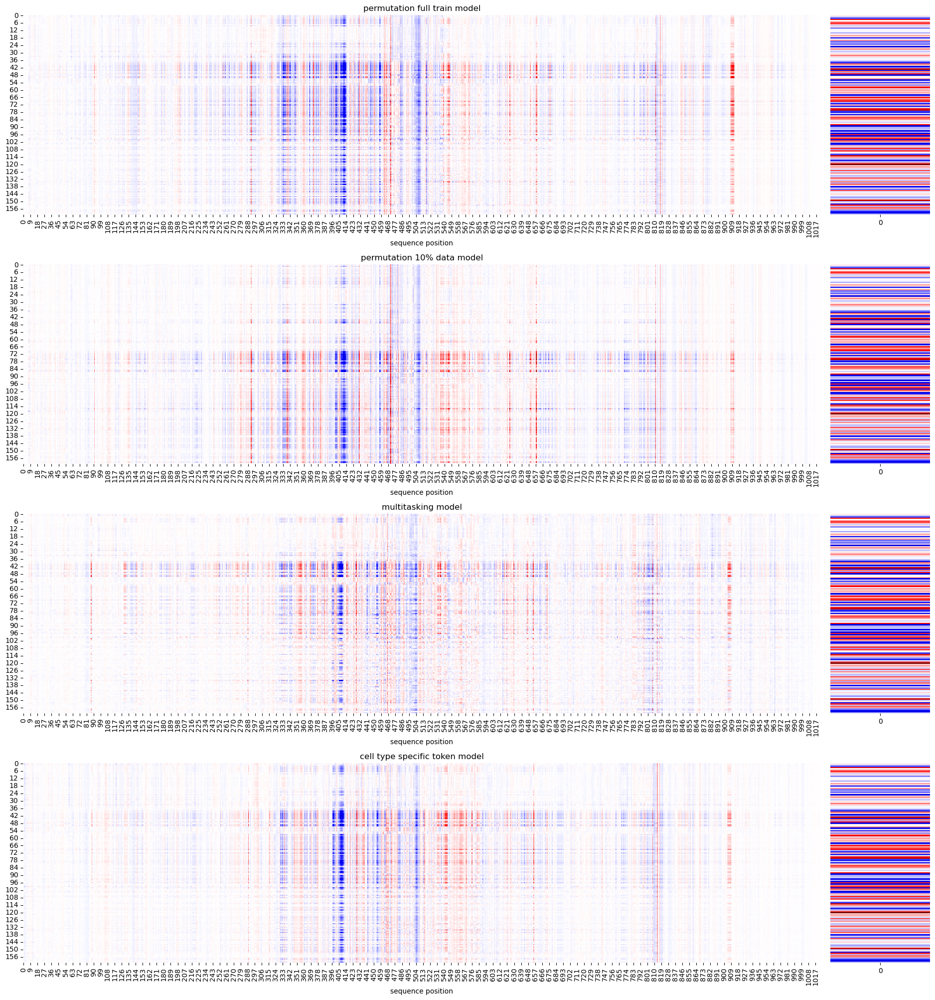

In [29]:
import matplotlib.pyplot as plt
import seaborn as sns

fig = plt.figure(figsize=(20, 20))

# Assuming global_min, global_max, and results_list are defined as before
# true_values is also defined

# Dimensions for main and secondary heatmaps
main_heatmap_width = 0.8
secondary_heatmap_width = 0.1
gap_between_heatmaps = 0.01
height = 0.2  # Adjust based on your preference for the subplot height
vertical_gap = 0.05  # Gap between rows

for j, i in enumerate(results_list):
    # Calculate positions of main and secondary heatmaps
    main_left = 0.1  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    
    bottom = 0.1 + (height + vertical_gap) * (3 - j)  # Starting position from bottom, adjust for each row
    
    # Create axes for main heatmap
    ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
    sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')

    # Create axes for secondary heatmap (true_values)
    ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])
    sns.heatmap(true_values.unsqueeze(1), cmap='seismic', center=0, ax=ax_secondary, cbar=False, vmin=global_min, vmax=global_max)
    # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
    ax_secondary.set_yticks([])

plt.show()


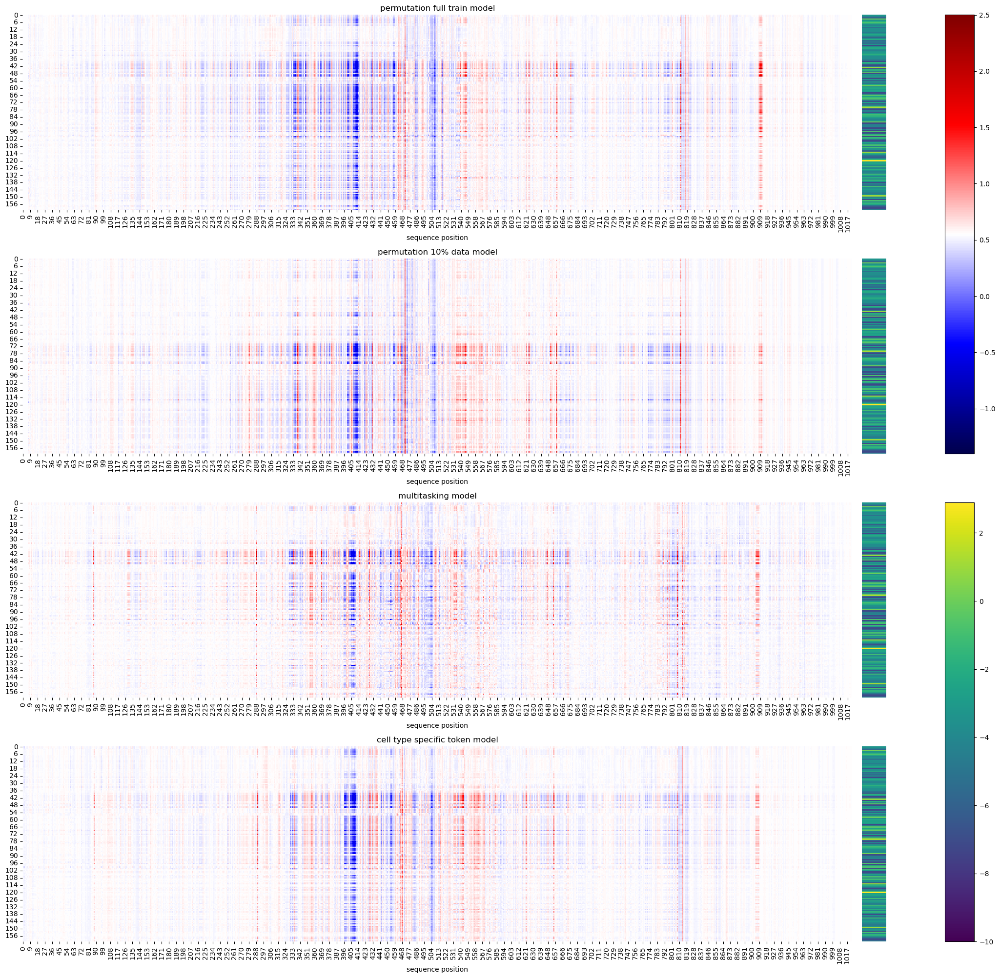

In [42]:
#now make it work with the heatmaps, we will maek it thinner and add the colorbars
fig = plt.figure(figsize=(20, 20))


# Dimensions for main and secondary heatmaps
main_heatmap_width = 0.85
secondary_heatmap_width = 0.025
colorbar_width = .05
gap_between_heatmaps = 0.01
height = 0.2  # Adjust based on your preference for the subplot height
vertical_gap = 0.05  # Gap between rows

for j, i in enumerate(results_list):
    # Calculate positions of main and secondary heatmaps
    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    
    bottom = 0.1 + (height + vertical_gap) * (3 - j)  # Starting position from bottom, adjust for each row
    
    # Create axes for main heatmap
    ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
    sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')

    # Create axes for secondary heatmap (true_values)
    ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])
    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=global_min, vmax=global_max)
    # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])

fig.subplots_adjust(right=0.95)
cbar_ax = fig.add_axes([tertiary_left+.025, 0.1, 0.03, 0.45])  # Adjust the dimensions as needed
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
fig.colorbar(sm, cax=cbar_ax)
cbar_ax = fig.add_axes([tertiary_left+.025, 0.6, 0.03, 0.45])  # Adjust the dimensions as needed
sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max))
fig.colorbar(sm, cax=cbar_ax)

# ax_tertiary = fig.add_axes([tertiary_left, 0.1, colorbar_width, 0.8])

plt.show()


Text(0.5, 1.0, 'cell type specific token model')

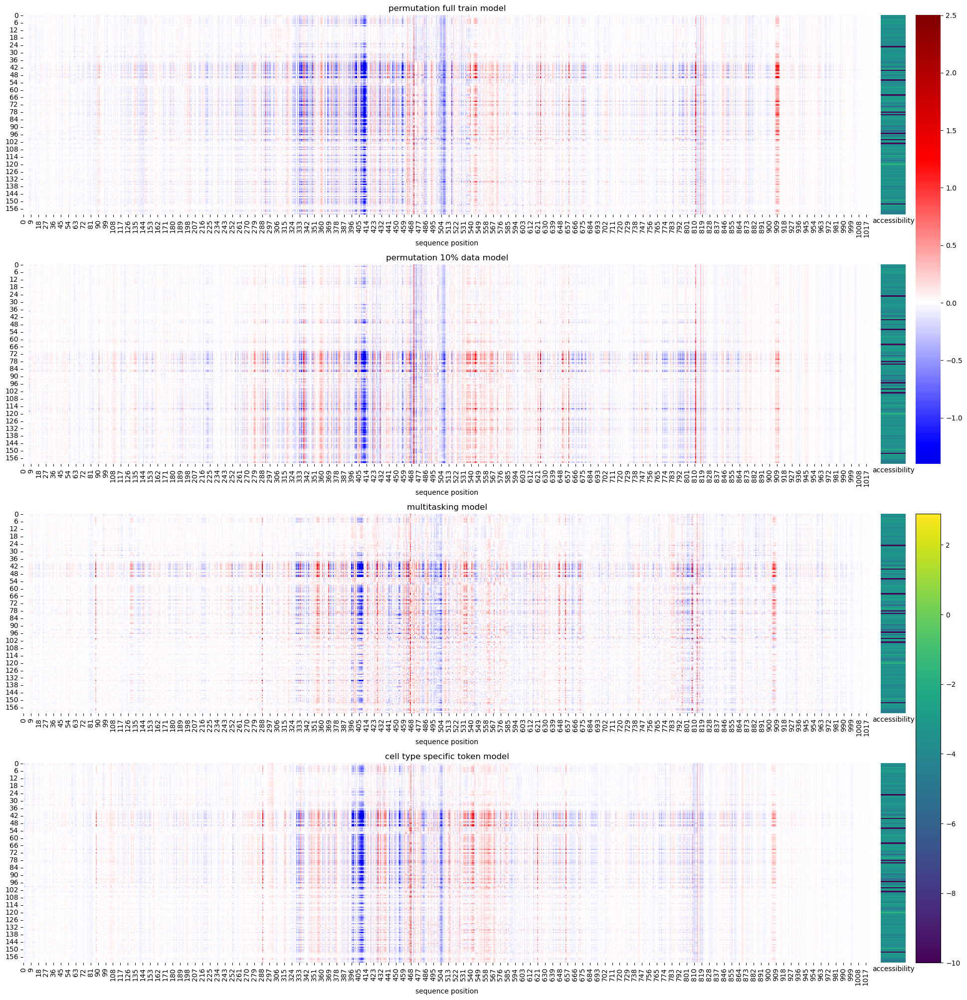

In [49]:
#now make it work with the heatmaps, we will maek it thinner and add the colorbars
fig = plt.figure(figsize=(20, 20))
from matplotlib.colors import TwoSlopeNorm

# Dimensions for main and secondary heatmaps
main_heatmap_width = 0.85
secondary_heatmap_width = 0.025
colorbar_width = .025
gap_between_heatmaps = 0.01
height = 0.2  # Adjust based on your preference for the subplot height
vertical_gap = 0.05  # Gap between rows

main_left = 0.05  # Starting position of the main heatmap (left)
secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)

for j, i in enumerate(results_list):
    # Calculate positions of main and secondary heatmaps    
    bottom = 0.1 + (height + vertical_gap) * (3 - j)  # Starting position from bottom, adjust for each row
    # Create axes for main heatmap
    ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
    sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')

    # Create axes for secondary heatmap (true_values)
    ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])
    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
    # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

fig.subplots_adjust(right=0.9)
cbar_ax = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
fig.colorbar(sm, cax=cbar_ax)
cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
# sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max), center=0)
norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)
sm = plt.cm.ScalarMappable(cmap='seismic', norm=norm)
fig.colorbar(sm, cax=cbar_ax)

#let's redraw the last one
sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
ax_main.set_xlabel('sequence position')
ax_main.set_title(f'{name_list[j]} model')


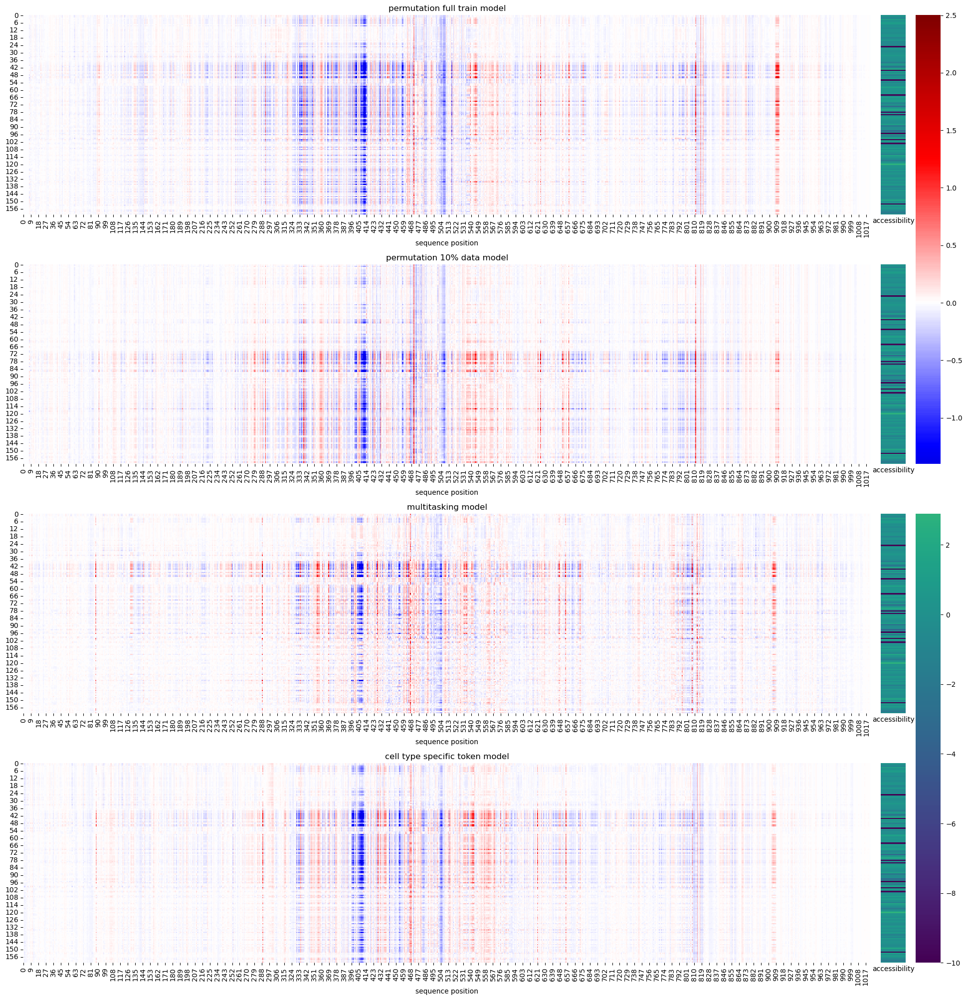

In [54]:
#now define a function and see what happens if we don't make it the full height
def multi_ism(results_list):
    #now make it work with the heatmaps, we will maek it thinner and add the colorbars
    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.2  # Adjust based on your preference for the subplot height
    vertical_gap = 0.05  # Gap between rows

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (3 - j)  # Starting position from bottom, adjust for each row
        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        if j == len(results_list)-1:
            continue

        sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model')

        # Create axes for secondary heatmap (true_values)
        sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max), center=0)
    # norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=norm)
    # fig.colorbar(sm, cax=cbar_ax)

    #let's redraw the last one so we can easily draw the colorbars
    sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')

    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

multi_ism(results_list)

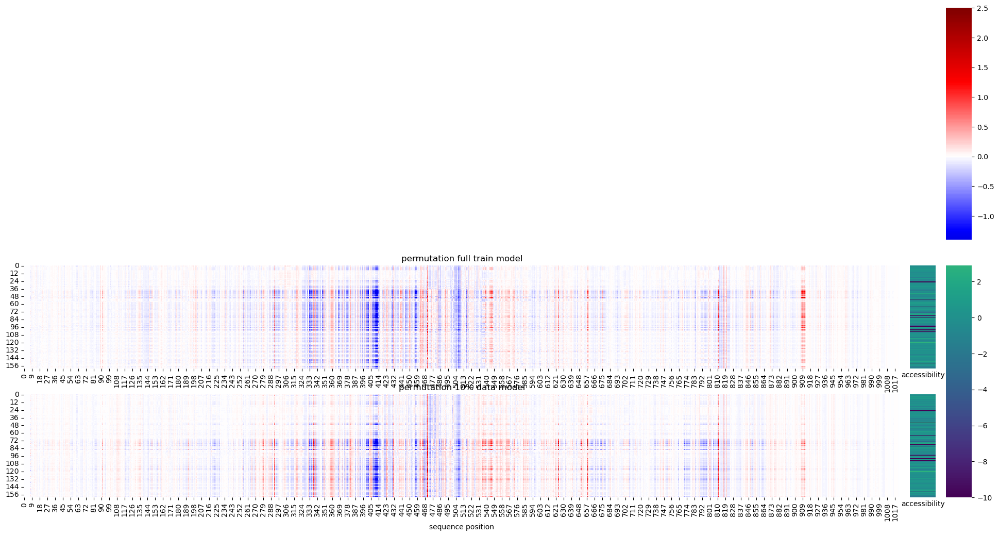

In [55]:
multi_ism(results_list[:2])

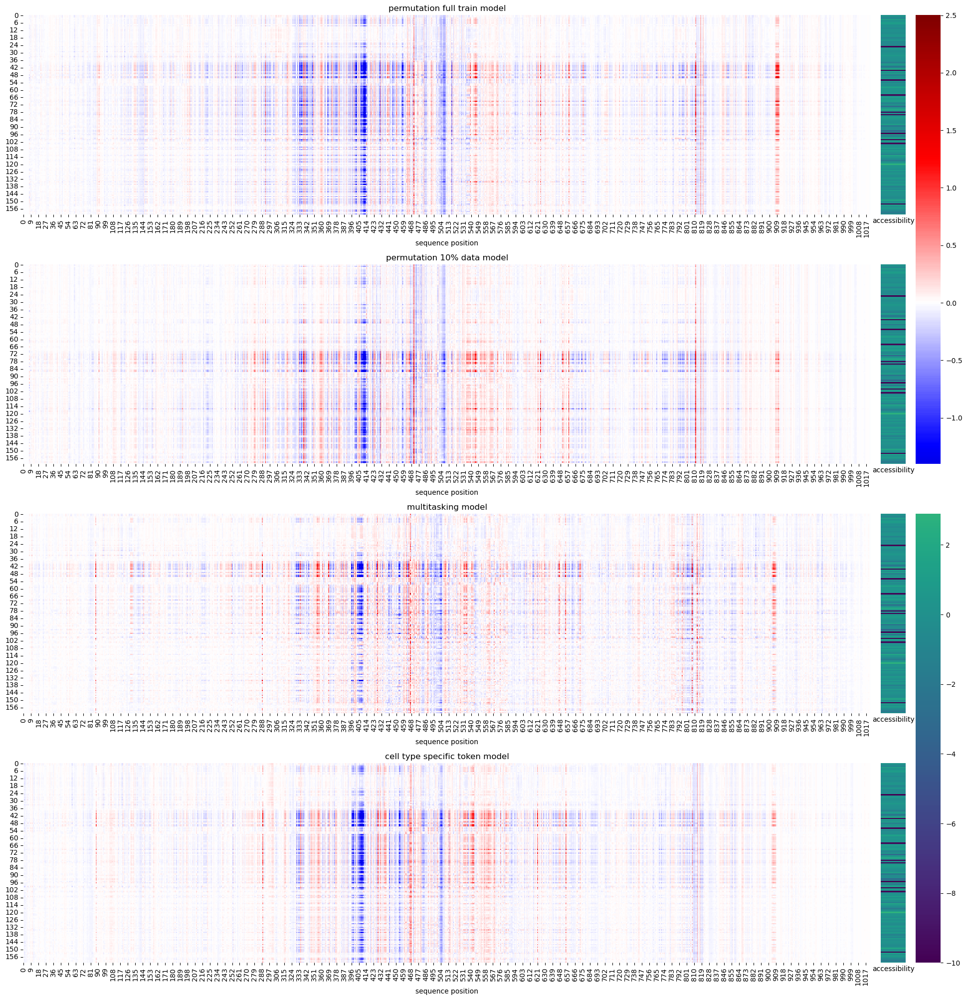

In [60]:
#now define a function and see what happens if we don't make it the full height
def multi_ism(results_list):
    #now make it work with the heatmaps, we will maek it thinner and add the colorbars
    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        if j == len(results_list)-1:
            continue

        sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model')

        # Create axes for secondary heatmap (true_values)
        sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max), center=0)
    # norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=norm)
    # fig.colorbar(sm, cax=cbar_ax)

    #let's redraw the last one so we can easily draw the colorbars
    sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')

    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

multi_ism(results_list)

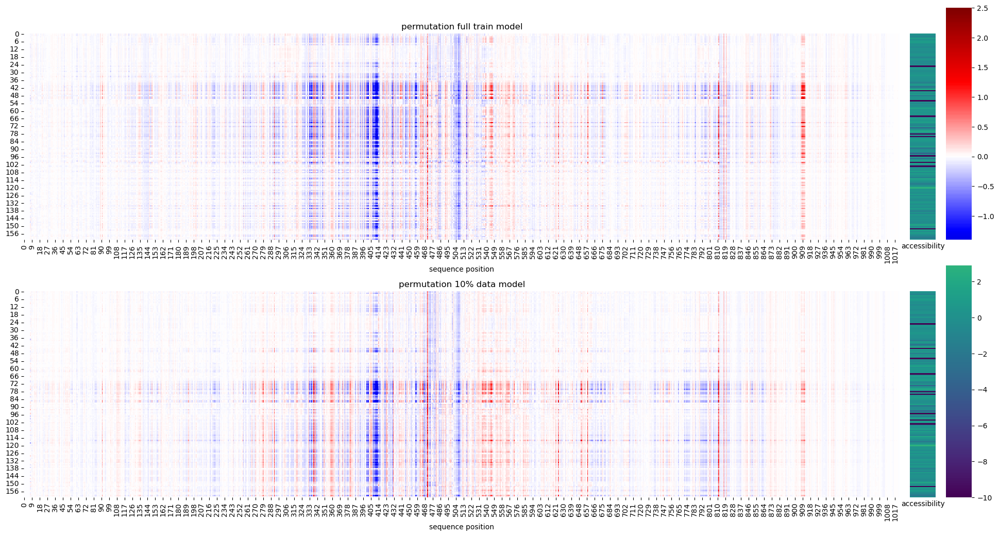

In [61]:
multi_ism(results_list[:2])

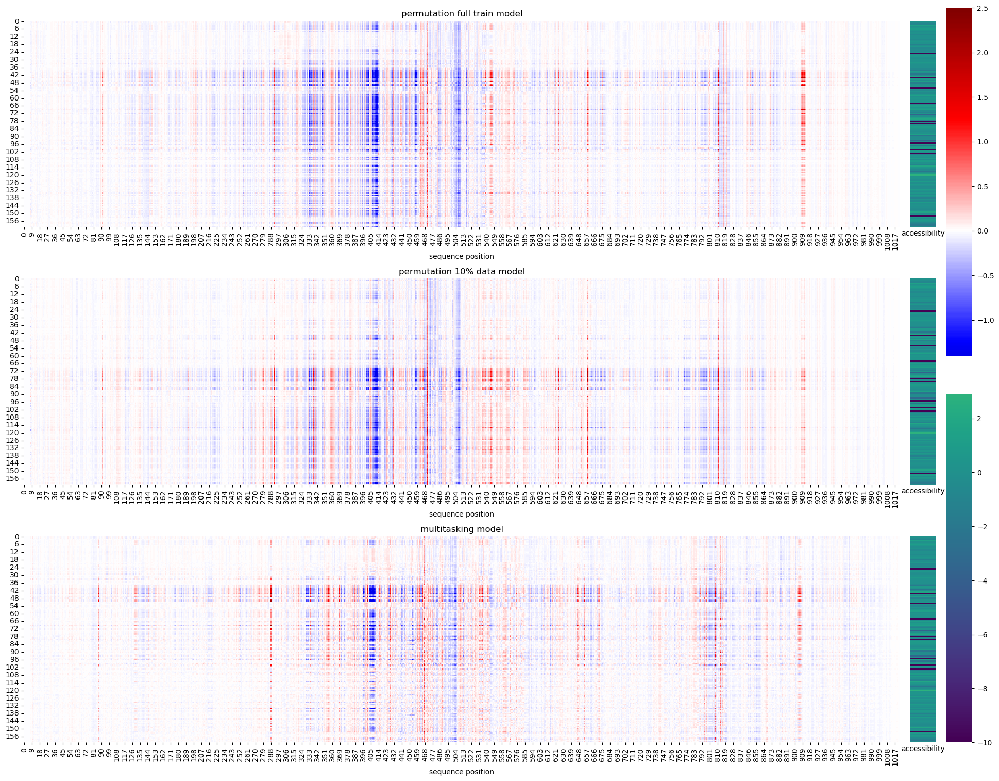

In [62]:
multi_ism(results_list[:3])

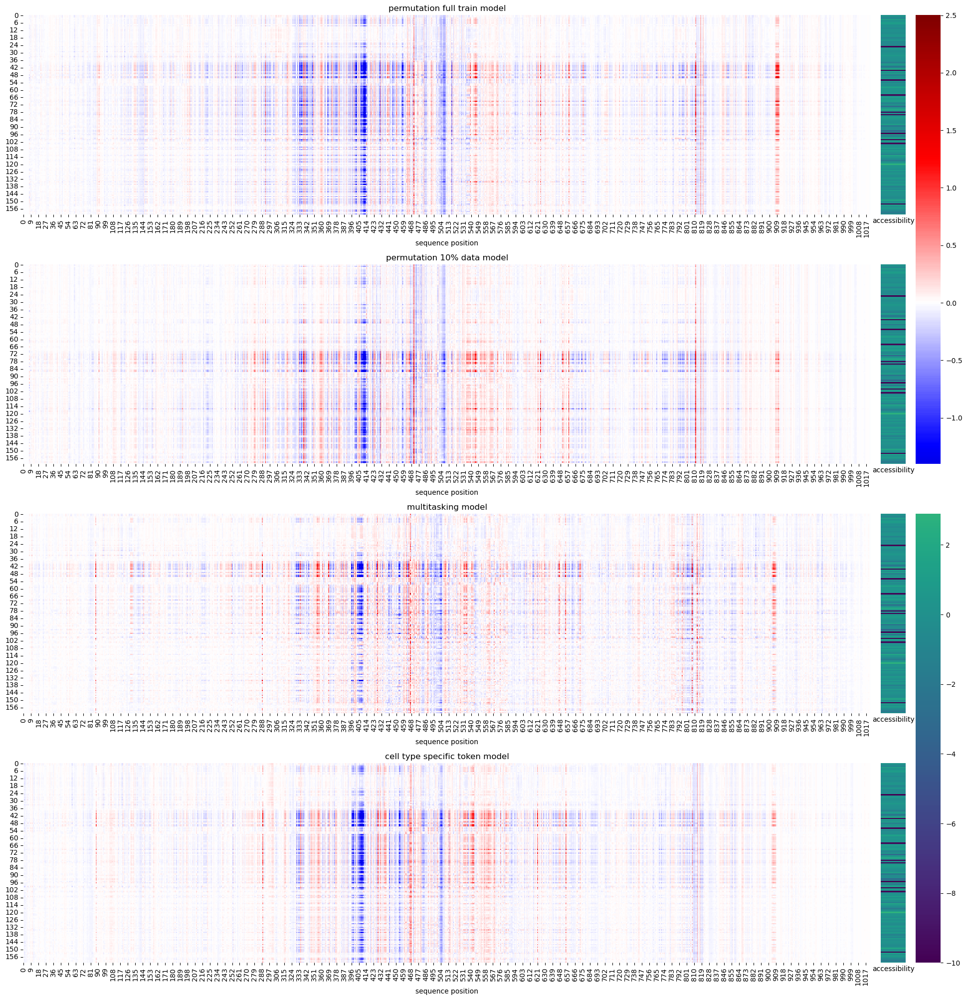

In [ ]:
#now define a function and see what happens if we don't make it the full height
def multi_ism(results_list, true_values, name_list):
    #now make it work with the heatmaps, we will maek it thinner and add the colorbars
    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        if j == len(results_list)-1:
            continue

        sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model')

        # Create axes for secondary heatmap (true_values)
        sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max), center=0)
    # norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=norm)
    # fig.colorbar(sm, cax=cbar_ax)

    #let's redraw the last one so we can easily draw the colorbars
    sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')

    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

multi_ism(results_list)

# clustermap

In [1]:
#now that we have the approach to do it, can do it and label it properly
#we have tons of model results! Now let's plot it for various cCREs, preferably ones that are enhanceers,, let's find some that are enhancers

#first plot the results of all 4 in a 2x2 scatter plot to see how well it does!
from shap_analysis.ism_utils import ISMUtils
multitasking_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-23/09-35-33-196632/checkpoints/381-val_loss=3.57483.ckpt'
cts_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-29/15-45-02-282170/checkpoints/last.ckpt'
cts_path2 = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-09/17-38-16-568113/checkpoints/last.ckpt' #this is again the 10% 100 epochs one
ctst_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-23/09-35-11-173861/checkpoints/last.ckpt'

#let's try the ctst path
util_cts = ISMUtils('DNase',cts_path, cfg = 'DNase_full.yaml')
util_cts2 = ISMUtils('DNase',cts_path2)
util_multitask = ISMUtils('DNase_allcelltypes',multitasking_path)
util_ctst = ISMUtils('DNase_ctst',ctst_path)
#set idx to 15 and replot
import matplotlib.pyplot as plt
utils_list = [util_cts, util_cts2, util_multitask, util_ctst]
name_list = ['permutation full train', 'permutation 10% data', 'multitasking', 'cell type specific token']


In [2]:
#load in all the results
import numpy as np
ism15_cts2 = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_15.npy')
ism15_multitask = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_allcelltypes15.npy')
ism15_cts = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_fulltrain15.npy')
ism15_ctst = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_ctst15.npy')
print(ism15_cts2.shape, ism15_multitask.shape, ism15_cts.shape, ism15_ctst.shape)
import seaborn as sns
results_list = [ism15_cts, ism15_cts2, ism15_multitask, ism15_ctst]

(4, 1023, 161) (4, 1023, 161) (4, 1023, 161) (4, 1024, 161)


In [12]:
true_values = util_multitask.dataset[15][1]

TypeError: seaborn.matrix.heatmap() got multiple values for keyword argument 'ax'

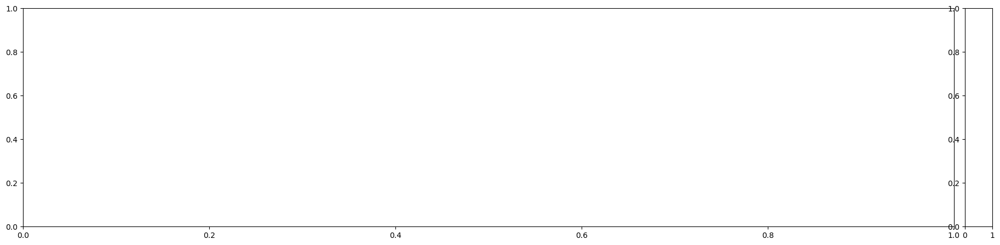

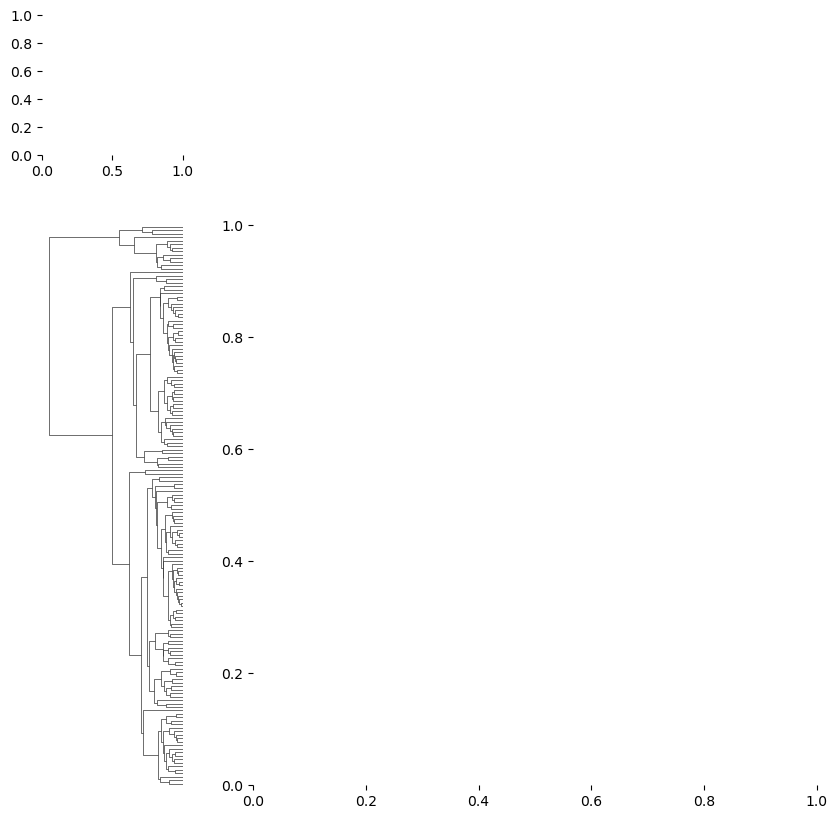

In [4]:
#now define a function and see what happens if we don't make it the full height
def multi_cluster(results_list):
    #now make it work with the heatmaps, we will maek it thinner and add the colorbars
    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        if j == len(results_list)-1:
            continue

        # sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, ax = ax_main, cbar=False, vmin=global_min, vmax=global_max)
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model')

        # Create axes for secondary heatmap (true_values)
        sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max), center=0)
    # norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=norm)
    # fig.colorbar(sm, cax=cbar_ax)

    #let's redraw the last one so we can easily draw the colorbars
    # sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, ax = ax_main, cbar_ax = cbar_ax, vmin=global_min, vmax=global_max)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')

    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

multi_cluster(results_list)

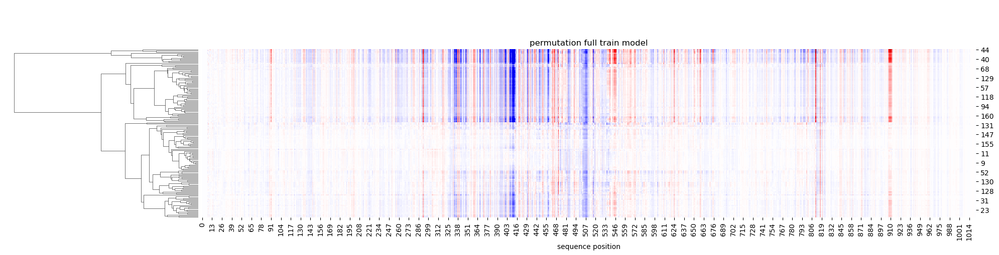

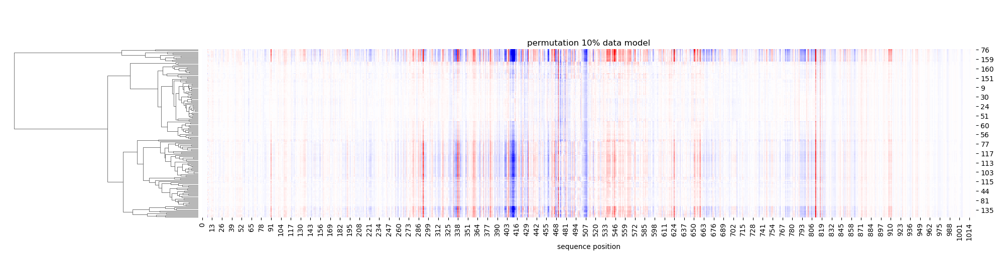

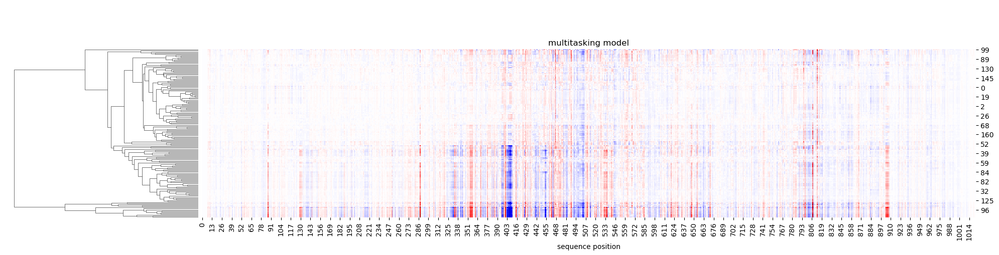

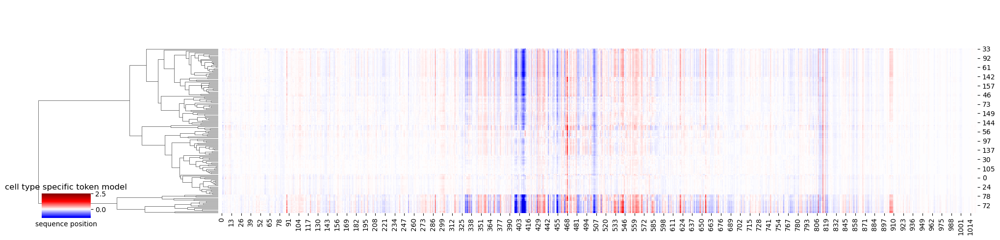

In [7]:
#let's just do the easy thing of do 4 plots

#now define a function and see what happens if we don't make it the full height
def multi_cluster(results_list):
    #now make it work with the heatmaps, we will maek it thinner and add the colorbars
    # fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    # main_heatmap_width = 0.85
    # secondary_heatmap_width = 0.025
    # colorbar_width = .025
    # gap_between_heatmaps = 0.01
    # height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    # vertical_gap = 0.2/len(results_list)  # Gap between rows

    # main_left = 0.05  # Starting position of the main heatmap (left)
    # secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    # tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    # total_vertical_space_per_heatmap = height + vertical_gap
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        # bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        # ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        # ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        if j == len(results_list)-1:
            continue

        # sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, cbar_pos=None, vmin=global_min, vmax=global_max, figsize=(20,5))
        plt.xlabel('sequence position')
        plt.title(f'{name_list[j]} model')

        # Create axes for secondary heatmap (true_values)
        # sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        # ax_secondary.set_yticks([])
        # ax_secondary.set_xticks([])
        # ax_secondary.set_xlabel('accessibility')

    # fig.subplots_adjust(right=0.9)
    # cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    # cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max), center=0)
    # norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=norm)
    # fig.colorbar(sm, cax=cbar_ax)

    #let's redraw the last one so we can easily draw the colorbars
    # sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.1))
    plt.xlabel('sequence position')
    plt.title(f'{name_list[j]} model')

    # sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    # ax_secondary.set_yticks([])
    # ax_secondary.set_xticks([])
    # ax_secondary.set_xlabel('accessibility')

multi_cluster(results_list)

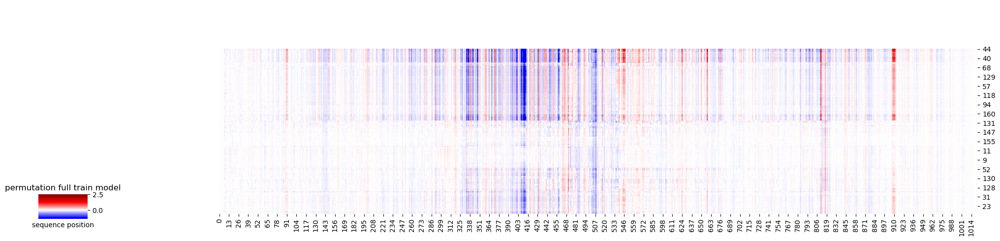

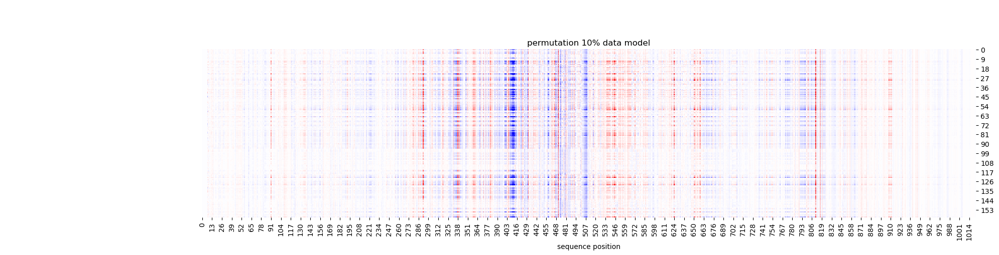

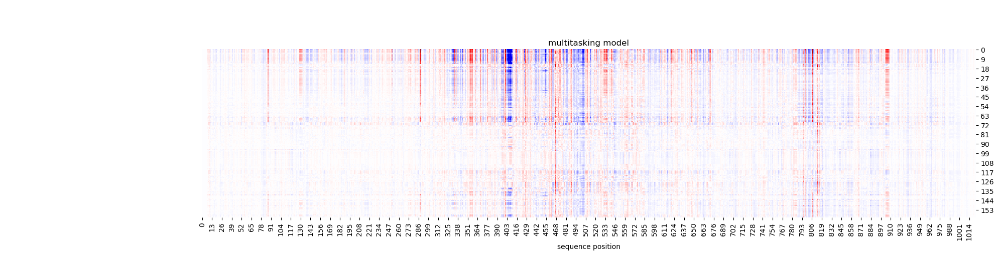

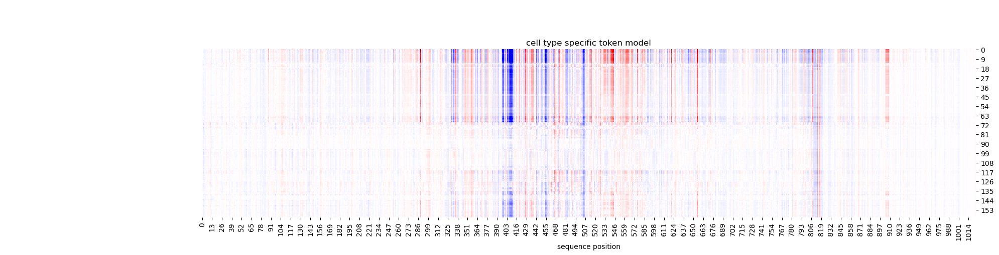

In [10]:
#let's just do the easy thing of do 4 plots

#now define a function and see what happens if we don't make it the full height
def multi_cluster(results_list):
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    

    for j, i in enumerate(results_list):
        if j == 0:
            g = sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.1))
            g.ax_row_dendrogram.set_visible(False)
            plt.xlabel('sequence position')
            plt.title(f'{name_list[j]} model')
            row_order = g.dendrogram_row.reordered_ind
            continue
        tempdata = i.sum(axis=0).T
        data_reordered = tempdata[row_order]
        g2 = sns.clustermap(data_reordered, cmap = 'seismic', center = 0,col_cluster=False, row_cluster=False, cbar_pos=None, vmin=global_min, vmax=global_max, figsize=(20,5))
        plt.xlabel('sequence position')
        plt.title(f'{name_list[j]} model')

    # sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.1))
    # plt.xlabel('sequence position')
    # plt.title(f'{name_list[j]} model')

multi_cluster(results_list)

In [12]:
#now let's add a heatmapt to the left side of each of these, since the axis is already there, it's easy.

#now define a function and see what happens if we don't make it the full height
def multi_cluster(results_list, true_values, name_list):
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    

    for j, i in enumerate(results_list):
        if j == 0:
            g = sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.1))
            g.ax_row_dendrogram.set_visible(False)
            plt.xlabel('sequence position')
            plt.title(f'{name_list[j]} model')
            row_order = g.dendrogram_row.reordered_ind
            #now let's sort true_values
            sorted_true = true_values[row_order]
            ax_secondary = g.fig.add_axes([.02,.1,.06,.6])
            sns.heatmap(sorted_true.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
            ax_secondary.set_yticks([])
            ax_secondary.set_xticks([])
            continue
        tempdata = i.sum(axis=0).T
        data_reordered = tempdata[row_order]
        g2 = sns.clustermap(data_reordered, cmap = 'seismic', center = 0,col_cluster=False, row_cluster=False, cbar_pos=None, vmin=global_min, vmax=global_max, figsize=(20,5))
        plt.xlabel('sequence position')
        plt.title(f'{name_list[j]} model')

    # sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.1))
    # plt.xlabel('sequence position')
    # plt.title(f'{name_list[j]} model')

multi_cluster(results_list, true_values, name_list)

NameError: name 'true_values' is not defined

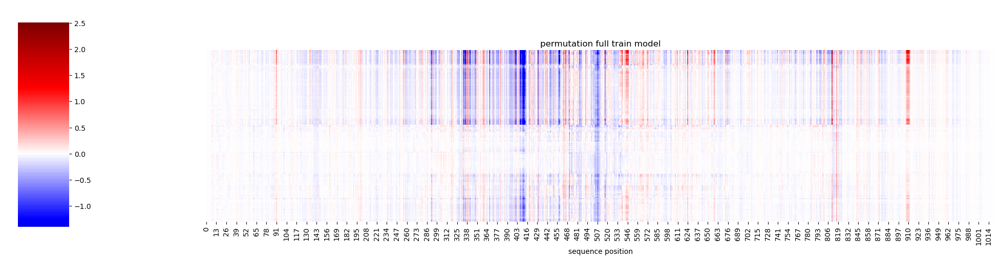

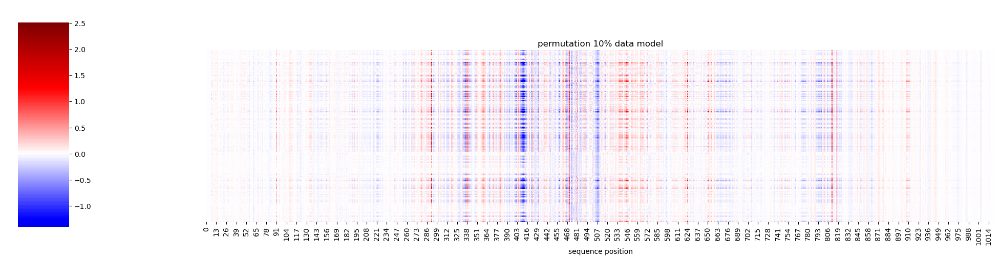

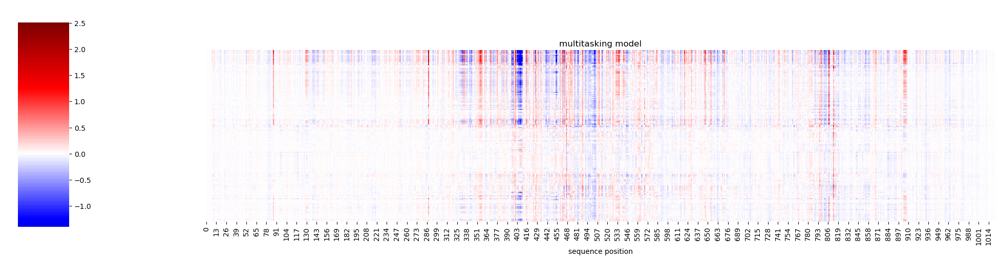

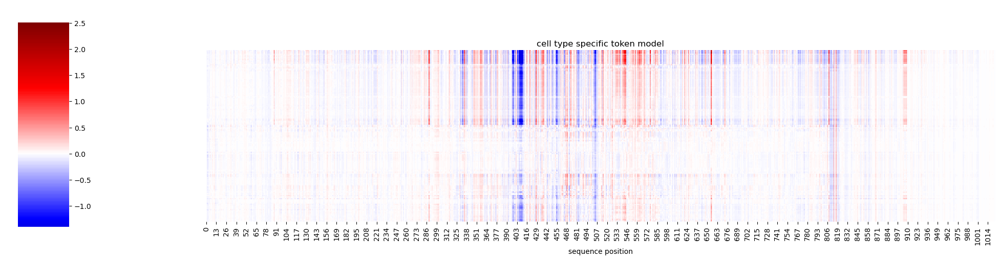

In [9]:
#before we do that, figure out the subplots, and also do the difference plots, and finally make sure they are all aligned
#now define a function and see what happens if we don't make it the full height
def multi_cluster(results_list):
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    for j, i in enumerate(results_list):
        if j == 0:
            g = sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
            g.ax_row_dendrogram.set_visible(False)
            g.ax_heatmap.set_xlabel('sequence position')
            g.ax_heatmap.set_title(f'{name_list[j]} model')
            #now set a title for the colorbar
            # g.ax_colorbar.set_title('ISM score')
            # plt.xlabel('sequence position')
            # plt.title(f'{name_list[j]} model')
            row_order = g.dendrogram_row.reordered_ind
            plt.close(g.fig)
            # continue
        tempdata = i.sum(axis=0).T
        data_reordered = tempdata[row_order]
        g2 = sns.clustermap(data_reordered, cmap = 'seismic', center = 0,col_cluster=False, row_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
        g2.ax_heatmap.set_xlabel('sequence position')
        g2.ax_heatmap.set_title(f'{name_list[j]} model')
        g2.ax_heatmap.set_yticks([])
        # plt.xlabel('sequence position')
        # plt.title(f'{name_list[j]} model')

    # sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.1))
    # plt.xlabel('sequence position')
    # plt.title(f'{name_list[j]} model')

multi_cluster(results_list)

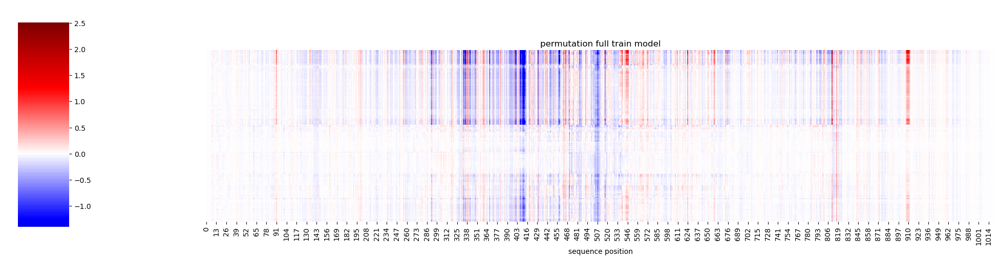

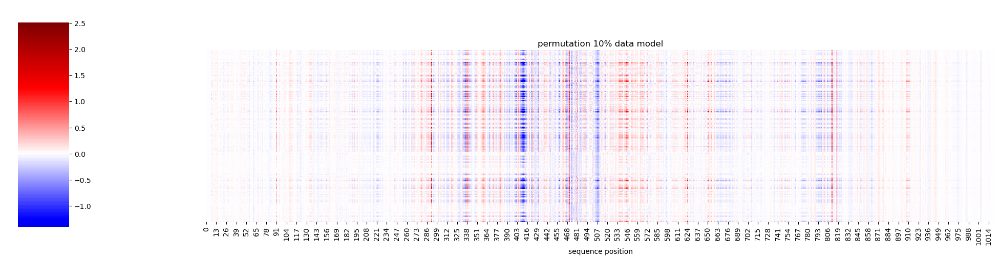

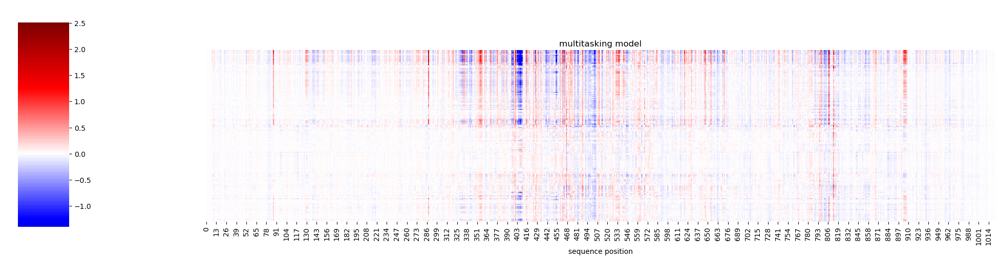

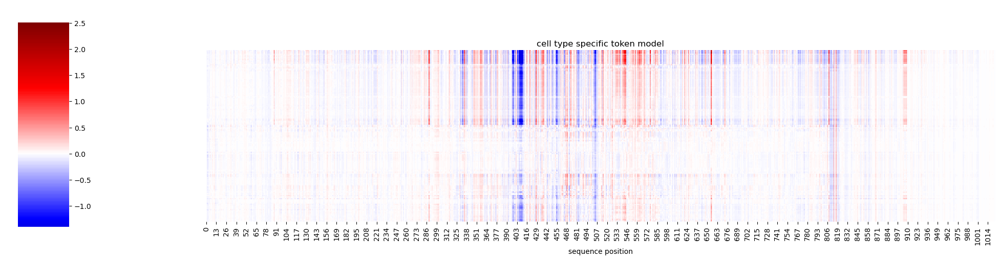

In [10]:
#use clustermap and then heatmap plots!! best of both worlds!!
#before we do that, figure out the subplots, and also do the difference plots, and finally make sure they are all aligned
#now define a function and see what happens if we don't make it the full height
def multi_cluster(results_list, cluster_index = 0):
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    #uses index to determine which model in results list is used for clustering
    i = results_list[cluster_index]
    g = sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
    row_order = g.dendrogram_row.reordered_ind
    plt.close(g.figure)

    for j, i in enumerate(results_list):
        tempdata = i.sum(axis=0).T
        data_reordered = tempdata[row_order]
        g2 = sns.clustermap(data_reordered, cmap = 'seismic', center = 0,col_cluster=False, row_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
        g2.ax_heatmap.set_xlabel('sequence position')
        g2.ax_heatmap.set_title(f'{name_list[j]} model')
        g2.ax_heatmap.set_yticks([])
        # plt.xlabel('sequence position')
        # plt.title(f'{name_list[j]} model')

    # sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.1))
    # plt.xlabel('sequence position')
    # plt.title(f'{name_list[j]} model')

multi_cluster(results_list)

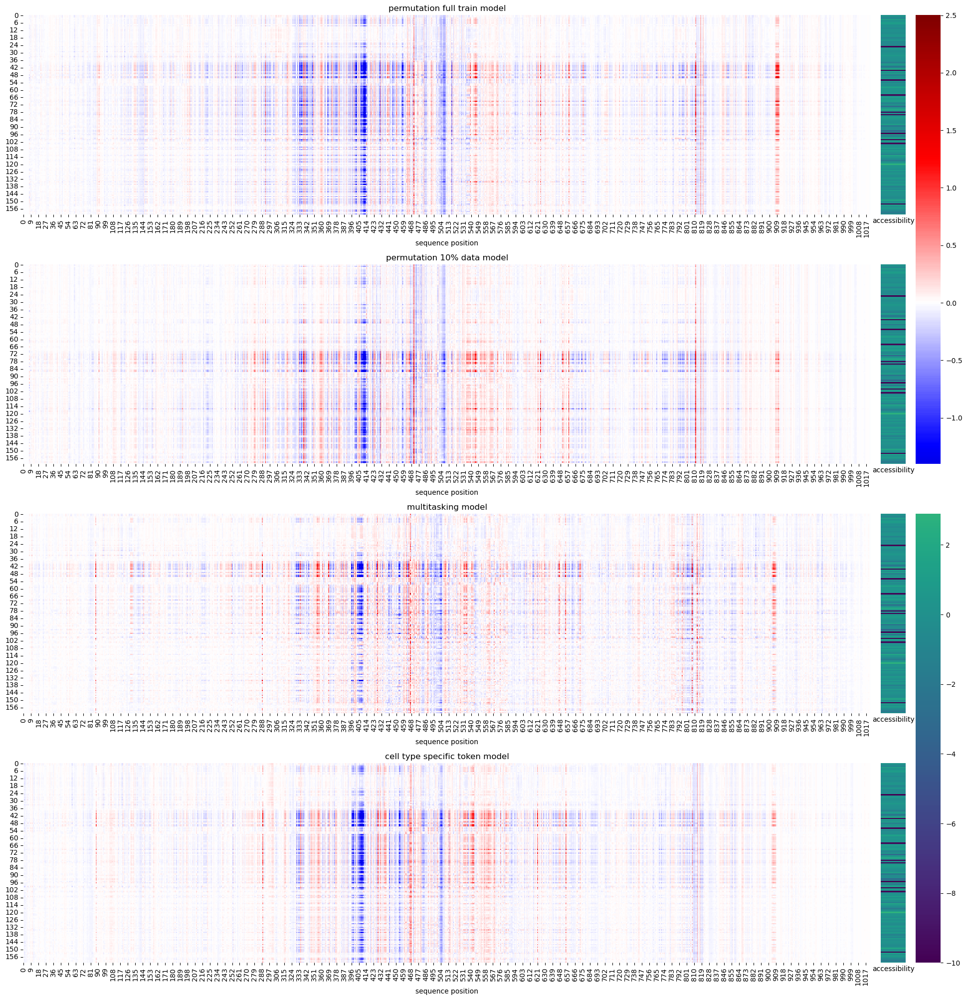

In [13]:
#first make sure we can get the normal heatmap to work again
#now define a function and see what happens if we don't make it the full height
def multi_ism(results_list, true_values, name_list):
    #now make it work with the heatmaps, we will maek it thinner and add the colorbars
    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        if j == len(results_list)-1:
            continue

        sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model')

        # Create axes for secondary heatmap (true_values)
        sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max), center=0)
    # norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=norm)
    # fig.colorbar(sm, cax=cbar_ax)

    #let's redraw the last one so we can easily draw the colorbars
    sns.heatmap(i.sum(axis=0).T, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')

    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

multi_ism(results_list, true_values, name_list)

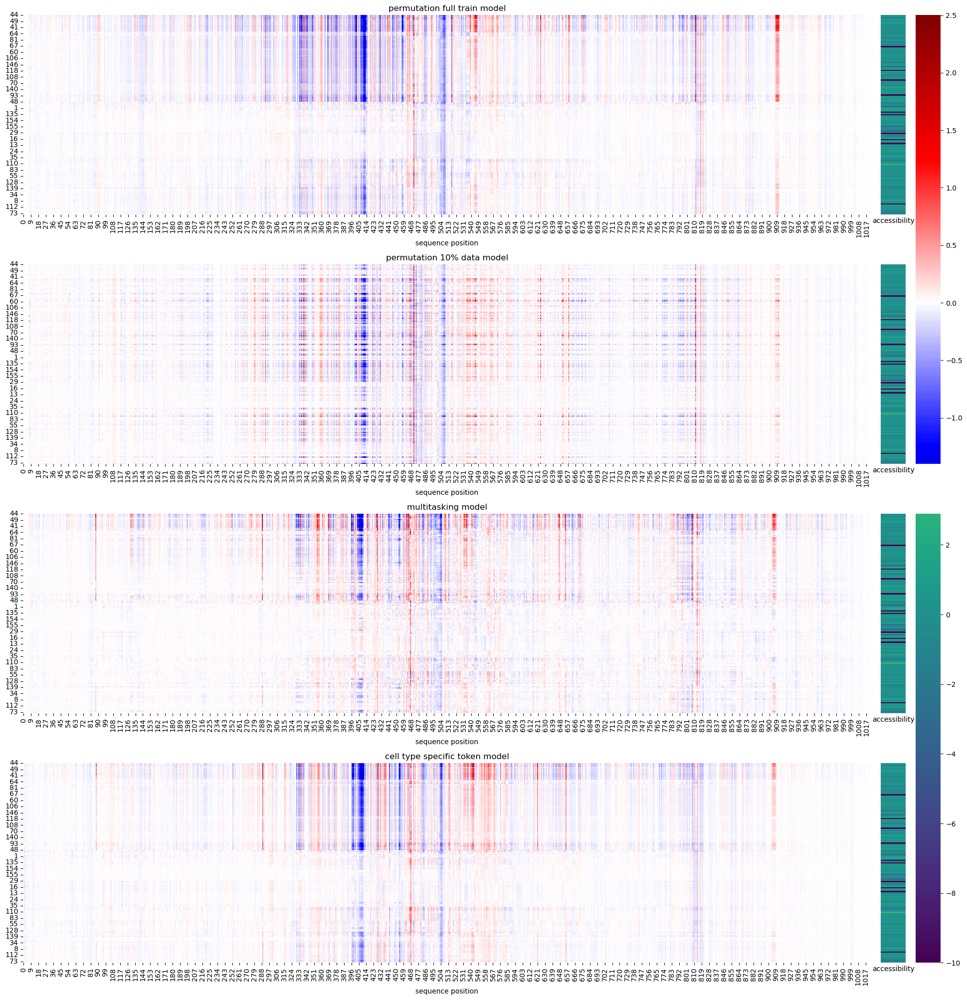

In [20]:
#let's actually just use the heatmap and go all the way!
def multi_cluster(results_list, true_values, name_list, cluster_index = 0):
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    #uses index to determine which model in results list is used for clustering
    i = results_list[cluster_index]
    g = sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
    row_order = g.dendrogram_row.reordered_ind
    plt.close(g.figure)

    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        if j == len(results_list)-1:
            continue
        temp_values = i.sum(axis=0).T
        sns.heatmap(temp_values[row_order], cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model')
        ax_main.set_yticks(range(0,161,5))
        ax_main.set_yticklabels(row_order[::5])

        # Create axes for secondary heatmap (true_values)
        sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max), center=0)
    # norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=norm)
    # fig.colorbar(sm, cax=cbar_ax)

    #let's redraw the last one so we can easily draw the colorbars
    sns.heatmap(i.sum(axis=0).T[row_order], cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')
    #now set the ytick labels to row_order
    ax_main.set_yticks(range(0,161,5))
    ax_main.set_yticklabels(row_order[::5])

    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

    # for j, i in enumerate(results_list):
    #     tempdata = i.sum(axis=0).T
    #     data_reordered = tempdata[row_order]
    #     g2 = sns.clustermap(data_reordered, cmap = 'seismic', center = 0,col_cluster=False, row_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
    #     g2.ax_heatmap.set_xlabel('sequence position')
    #     g2.ax_heatmap.set_title(f'{name_list[j]} model')
    #     g2.ax_heatmap.set_yticks([])
    #     # plt.xlabel('sequence position')
    #     # plt.title(f'{name_list[j]} model')

    # sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.1))
    # plt.xlabel('sequence position')
    # plt.title(f'{name_list[j]} model')

multi_cluster(results_list, true_values, name_list)

ValueError: operands could not be broadcast together with shapes (161,1024) (161,1023) 

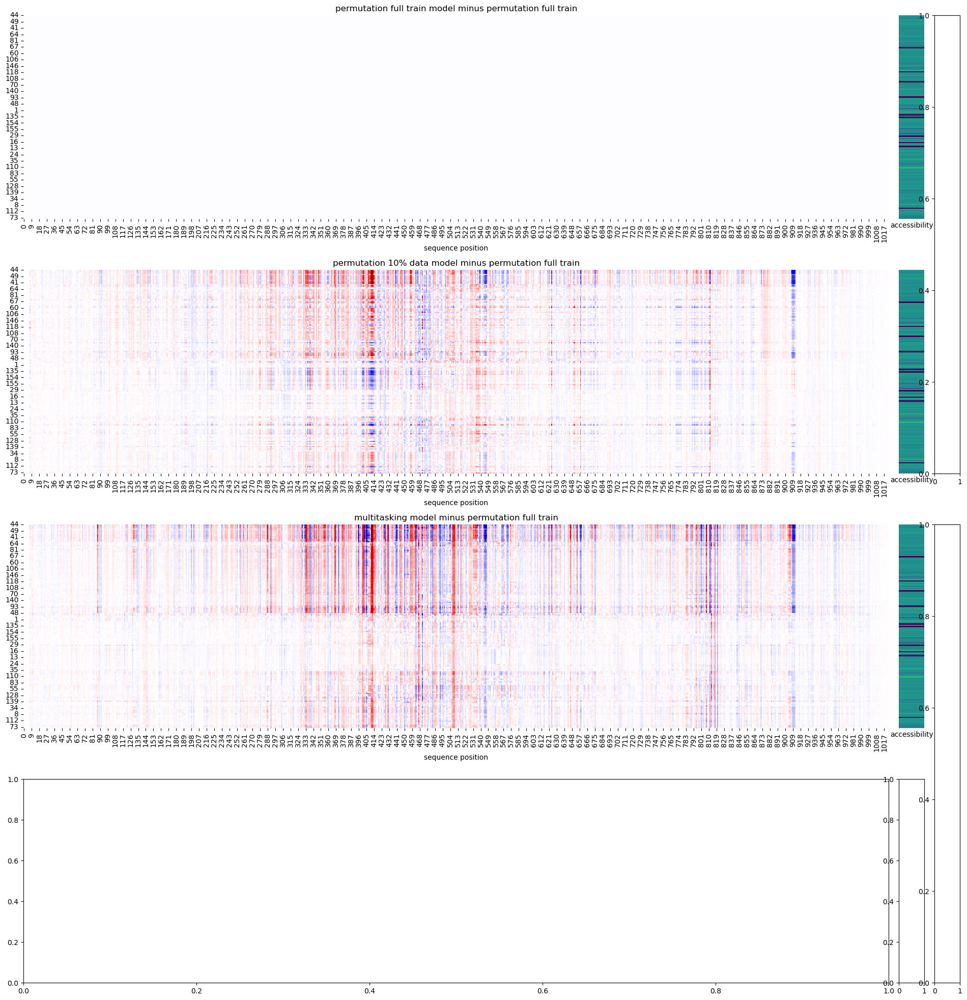

In [22]:
def multi_cluster_difference(results_list, true_values, name_list, cluster_index = 0):
    #here cluster index is used to find which one clusters but also which one we find the difference compared to
    #so like if 0, that one will be all zeros and is the one that is used for clustering
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    #uses index to determine which model in results list is used for clustering
    i = results_list[cluster_index]
    g = sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
    row_order = g.dendrogram_row.reordered_ind
    plt.close(g.figure)

    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])
        temp_values = i.sum(axis=0).T
        if j == cluster_index:
            real = temp_values[row_order]
        if j == len(results_list)-1:
            continue
        sns.heatmap(temp_values[row_order]-real, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model minus {name_list[cluster_index]}')
        ax_main.set_yticks(range(0,161,5))
        ax_main.set_yticklabels(row_order[::5])

        # Create axes for secondary heatmap (true_values)
        sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max), center=0)
    # norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=norm)
    # fig.colorbar(sm, cax=cbar_ax)

    #let's redraw the last one so we can easily draw the colorbars
    sns.heatmap(i.sum(axis=0).T[row_order]-real, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model minus {name_list[cluster_index]}')    #now set the ytick labels to row_order
    ax_main.set_yticks(range(0,161,5))
    ax_main.set_yticklabels(row_order[::5])

    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

    # for j, i in enumerate(results_list):
    #     tempdata = i.sum(axis=0).T
    #     data_reordered = tempdata[row_order]
    #     g2 = sns.clustermap(data_reordered, cmap = 'seismic', center = 0,col_cluster=False, row_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
    #     g2.ax_heatmap.set_xlabel('sequence position')
    #     g2.ax_heatmap.set_title(f'{name_list[j]} model')
    #     g2.ax_heatmap.set_yticks([])
    #     # plt.xlabel('sequence position')
    #     # plt.title(f'{name_list[j]} model')

    # sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.1))
    # plt.xlabel('sequence position')
    # plt.title(f'{name_list[j]} model')

multi_cluster_difference(results_list, true_values, name_list)

# fixing the difference plot
we have 2 main issues

1) we need to make sure that all the things are aligned if we're going to subtract them
2) change the scales to match, not just the same max and min, but rather it's the difference max and min
3) fix the lengths also being different, goes up to 1024 lol
4) likely needs to get the utils list in order to actually work

Let's start with the aligning, we know this from the multilogo and the dataset
If we ignore the cell type specific token, the rest of them is the same, let's just check from the dataset

In [25]:
#let's decode the full sequences and see how they align and what needs to be cut to make them align! Just make it part of the difference function, that way keep the rest
#this lets us keep the ism data
a,b = util_cts.dataset[15*161]
a2,b2 = util_cts2.dataset[15*161]
a3,b3 = util_multitask.dataset[15]
a4,b4 = util_ctst.dataset[15*161]

In [26]:
print(b,b2,b3[0],b4)
print(a[:15])
print(a2[:15])
print(a3[:15])
print(a4[:15])
#from this we can figure out exactly what we need to cut to make them align
#so we see that the cts models will just be shorter, cut the first 7 obviously
#then we can cut the first element of the ctst model, that will align, then cut the last 3 of the multitasking and ctst models

tensor([0.0899]) tensor([0.0899]) tensor(0.0899) tensor([0.0899])
tensor([12, 13, 14, 15, 16, 17, 18,  8, 10,  9, 10,  7, 10,  8,  7])
tensor([12, 13, 14, 15, 16, 17, 18,  8, 10,  9, 10,  7, 10,  8,  7])
tensor([ 8,  9,  9,  8, 10,  9, 10,  7, 10,  8,  7,  9,  9,  7,  7])
tensor([12,  8,  9,  9,  8, 10,  9, 10,  7, 10,  8,  7,  9,  9,  7])


In [27]:
tempa = a[7:]
tempa2 = a2[7:]
tempa3 = a3[3:-4] #also removes 7 of them!
tempa4 = a4[4:-4]
print(len(tempa), len(tempa2),len(tempa3),len(tempa4))

1016 1016 1016 1016


In [30]:
#now check to see if all are close
import torch
print(torch.allclose(tempa,tempa2, 0, 0)) #literally zero tolerance
print(torch.allclose(tempa,tempa3, 0, 0))
print(torch.allclose(tempa,tempa4, 0, 0))

True 0 0
True 0 0
True 0 0


In [31]:
print(tempa)
print(tempa2)
print(tempa3)
print(tempa4) #can clearly see that it's completely identical! So we know to easily calculate and print things

tensor([ 8, 10,  9,  ...,  7,  8,  8])
tensor([ 8, 10,  9,  ...,  7,  8,  8])
tensor([ 8, 10,  9,  ...,  7,  8,  8])
tensor([ 8, 10,  9,  ...,  7,  8,  8])


In [32]:
results_list[0].sum(axis=0).T.shape #need to use this to finalize things, lets us see if change columns or rows

(161, 1023)

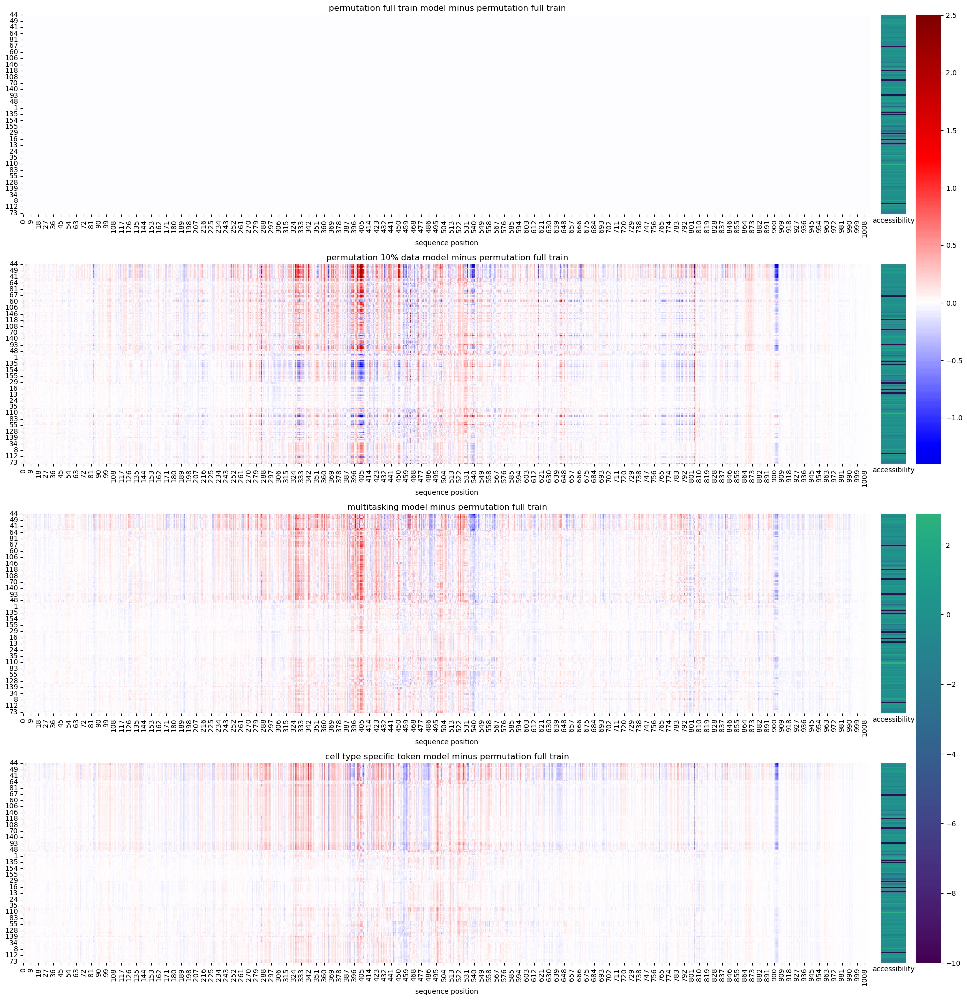

In [35]:
#start with aligning
#here's what we know from the multilogo

def multi_cluster_difference(utils_list, results_list, true_values, name_list, cluster_index = 0):
    #here cluster index is used to find which one clusters but also which one we find the difference compared to
    #so like if 0, that one will be all zeros and is the one that is used for clustering
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])
    #find the maximum
    max1 = global_max - global_min
    max2 = np.abs(global_min-global_max)
    max3 = max(max1,max2)

    #now we set it 
    global_min = -max3
    global_max = max3

    #uses index to determine which model in results list is used for clustering
    i = results_list[cluster_index]
    temp_values = i.sum(axis=0).T
    if utils_list[cluster_index].mtype == 'DNase':
        temp_values = temp_values[:,7:]
    elif utils_list[cluster_index].mtype == 'DNase_allcelltypes':
        temp_values = temp_values[:,3:-4]
    elif utils_list[cluster_index].mtype == 'DNase_ctst':
        temp_values = temp_values[:,4:-4]
    
    g = sns.clustermap(temp_values, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
    row_order = g.dendrogram_row.reordered_ind
    real = temp_values[row_order]
    plt.close(g.figure)

    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        temp_values = i.sum(axis=0).T
        #now let's align them all
        if utils_list[j].mtype == 'DNase':
            temp_values = temp_values[:,7:]
        elif utils_list[j].mtype == 'DNase_allcelltypes':
            temp_values = temp_values[:,3:-4]
        elif utils_list[j].mtype == 'DNase_ctst':
            temp_values = temp_values[:,4:-4]
        
        if j == len(results_list)-1:
            continue
        sns.heatmap(temp_values[row_order]-real, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model minus {name_list[cluster_index]}')
        ax_main.set_yticks(range(0,161,5))
        ax_main.set_yticklabels(row_order[::5])

        # Create axes for secondary heatmap (true_values)
        #now we can also organize the true_values
        temp_true = true_values[row_order].unsqueeze(1)
        sns.heatmap(temp_true, cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    
    sns.heatmap(temp_values[row_order]-real, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model minus {name_list[cluster_index]}')    #now set the ytick labels to row_order
    ax_main.set_yticks(range(0,161,5))
    ax_main.set_yticklabels(row_order[::5])

    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

multi_cluster_difference(utils_list, results_list, true_values, name_list)

# final steps

Fix the other plots to include that check and make sure they align based on the mtype  
Make sure that the accessibility column also gets clustered in the clustermaps!!  
Put it all in the ismutils file  
DONE!

In [1]:
#now that we have the approach to do it, can do it and label it properly
#we have tons of model results! Now let's plot it for various cCREs, preferably ones that are enhanceers,, let's find some that are enhancers

#first plot the results of all 4 in a 2x2 scatter plot to see how well it does!
from shap_analysis.ism_utils import ISMUtils
multitasking_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-23/09-35-33-196632/checkpoints/381-val_loss=3.57483.ckpt'
cts_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-29/15-45-02-282170/checkpoints/last.ckpt'
cts_path2 = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-09/17-38-16-568113/checkpoints/last.ckpt' #this is again the 10% 100 epochs one
ctst_path = '/data/leslie/sarthak/hyena/hyena-dna/outputs/2024-02-23/09-35-11-173861/checkpoints/last.ckpt'

#let's try the ctst path
util_cts = ISMUtils('DNase',cts_path, cfg = 'DNase_full.yaml')
util_cts2 = ISMUtils('DNase',cts_path2)
util_multitask = ISMUtils('DNase_allcelltypes',multitasking_path)
util_ctst = ISMUtils('DNase_ctst',ctst_path)
#set idx to 15 and replot
import matplotlib.pyplot as plt
utils_list = [util_cts, util_cts2, util_multitask, util_ctst]
name_list = ['permutation full train', 'permutation 10% data', 'multitasking', 'cell type specific token']

#load in all the results
import numpy as np
ism15_cts2 = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_15.npy')
ism15_multitask = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_allcelltypes15.npy')
ism15_cts = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_fulltrain15.npy')
ism15_ctst = np.load('/data/leslie/sarthak/hyena/hyena-dna/shap_analysis/saved_ISM/ISM_run1_normalized_ctst15.npy')
print(ism15_cts2.shape, ism15_multitask.shape, ism15_cts.shape, ism15_ctst.shape)
import seaborn as sns
results_list = [ism15_cts, ism15_cts2, ism15_multitask, ism15_ctst]
true_values = util_multitask.dataset[15][1] #use multitasking because it provides all the celltlypes simultaneously

(4, 1023, 161) (4, 1023, 161) (4, 1023, 161) (4, 1024, 161)


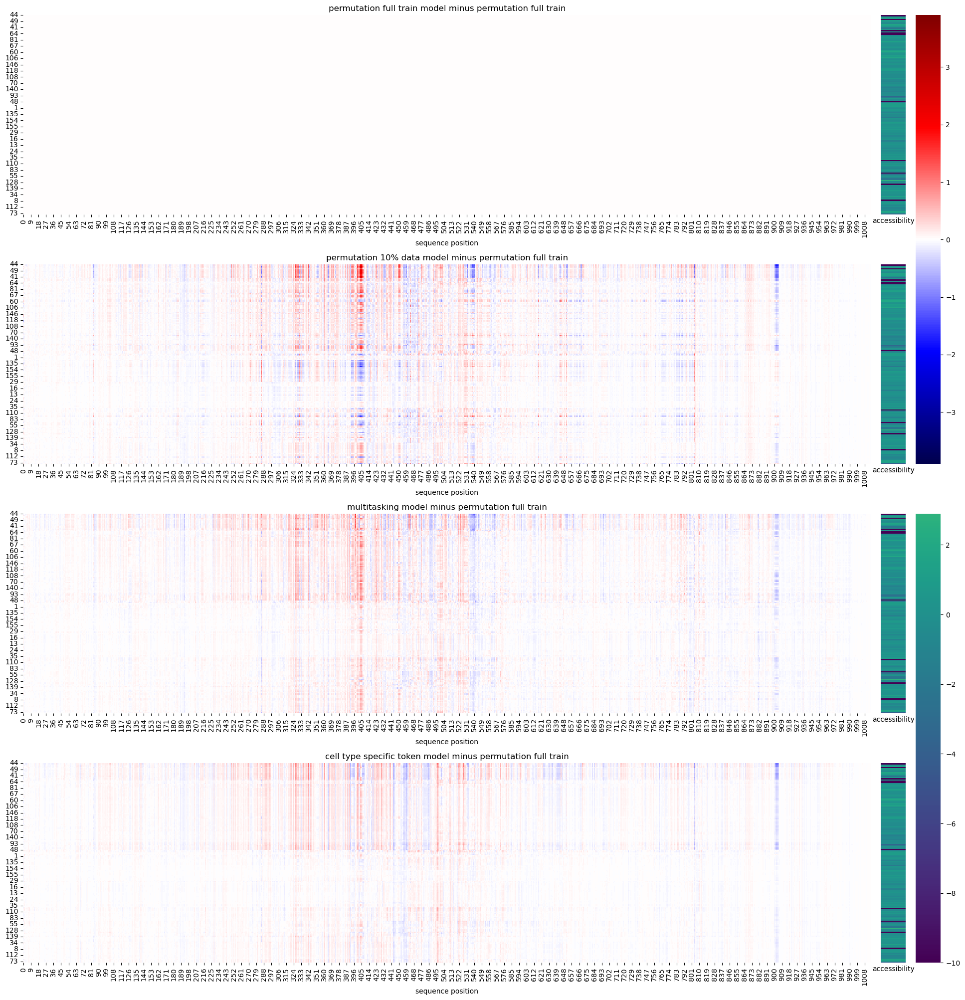

In [12]:
#start with aligning
#here's what we know from the multilogo

def multi_cluster_difference(utils_list, results_list, true_values, name_list, cluster_index = 0, return_vals = False):
    #here cluster index is used to find which one clusters but also which one we find the difference compared to
    #so like if 0, that one will be all zeros and is the one that is used for clustering
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])
    #find the maximum
    max1 = global_max - global_min
    max2 = np.abs(global_min-global_max)
    max3 = max(max1,max2)

    #now we set it 
    global_min = -max3
    global_max = max3

    #uses index to determine which model in results list is used for clustering
    i = results_list[cluster_index]
    temp_values = i.sum(axis=0).T
    if utils_list[cluster_index].mtype == 'DNase':
        temp_values = temp_values[:,7:]
    elif utils_list[cluster_index].mtype == 'DNase_allcelltypes':
        temp_values = temp_values[:,3:-4]
    elif utils_list[cluster_index].mtype == 'DNase_ctst':
        temp_values = temp_values[:,4:-4]
    
    g = sns.clustermap(temp_values, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
    row_order = g.dendrogram_row.reordered_ind
    real = temp_values[row_order]
    plt.close(g.figure)

    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap
    temp_true = true_values[row_order].unsqueeze(1)

    difference_list = []

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        temp_values = i.sum(axis=0).T
        #now let's align them all, required to subtract them
        if utils_list[j].mtype == 'DNase':
            temp_values = temp_values[:,7:]
        elif utils_list[j].mtype == 'DNase_allcelltypes':
            temp_values = temp_values[:,3:-4]
        elif utils_list[j].mtype == 'DNase_ctst':
            temp_values = temp_values[:,4:-4]
        
        if j == len(results_list)-1:
            continue
        sns.heatmap(temp_values[row_order]-real, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        difference_list.append(temp_values[row_order]-real)
        
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model minus {name_list[cluster_index]}')
        ax_main.set_yticks(range(0,161,5))
        ax_main.set_yticklabels(row_order[::5])

        # Create axes for secondary heatmap (true_values)
        #now we can also organize the true_values
        
        sns.heatmap(temp_true, cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    
    sns.heatmap(temp_values[row_order]-real, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    difference_list.append(temp_values[row_order]-real)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model minus {name_list[cluster_index]}')    #now set the ytick labels to row_order
    ax_main.set_yticks(range(0,161,5))
    ax_main.set_yticklabels(row_order[::5])

    sns.heatmap(temp_true, cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')
    if return_vals:
        return difference_list

multi_cluster_difference(utils_list, results_list, true_values, name_list)

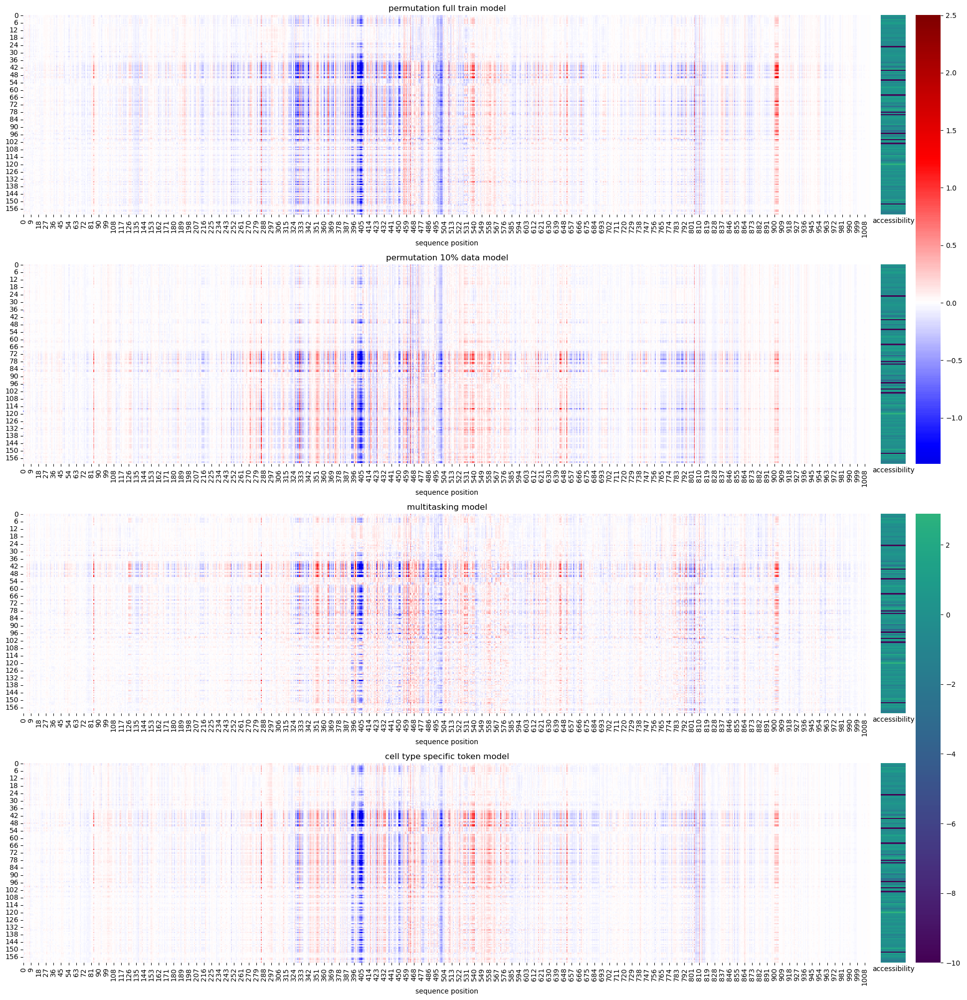

In [5]:
#first make sure we can get the normal heatmap to work again
#now define a function and see what happens if we don't make it the full height
def multi_ism(results_list, true_values, name_list, align_indices = True):
    #now make it work with the heatmaps, we will maek it thinner and add the colorbars
    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap
    # temp_true = true_values[row_order].unsqueeze(1)
    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        temp_values = i.sum(axis=0).T
        #now let's align them all
        if align_indices:
            if utils_list[j].mtype == 'DNase':
                temp_values = temp_values[:,7:]
            elif utils_list[j].mtype == 'DNase_allcelltypes':
                temp_values = temp_values[:,3:-4]
            elif utils_list[j].mtype == 'DNase_ctst':
                temp_values = temp_values[:,4:-4]

        if j == len(results_list)-1:
            continue

        sns.heatmap(temp_values, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model')

        # Create axes for secondary heatmap (true_values)
        sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=plt.Normalize(vmin=global_min, vmax=global_max), center=0)
    # norm = TwoSlopeNorm(vmin=global_min, vcenter=0, vmax=global_max)
    # sm = plt.cm.ScalarMappable(cmap='seismic', norm=norm)
    # fig.colorbar(sm, cax=cbar_ax)

    #let's redraw the last one so we can easily draw the colorbars
    sns.heatmap(temp_values, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')

    sns.heatmap(true_values.unsqueeze(1), cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

multi_ism(results_list, true_values, name_list)

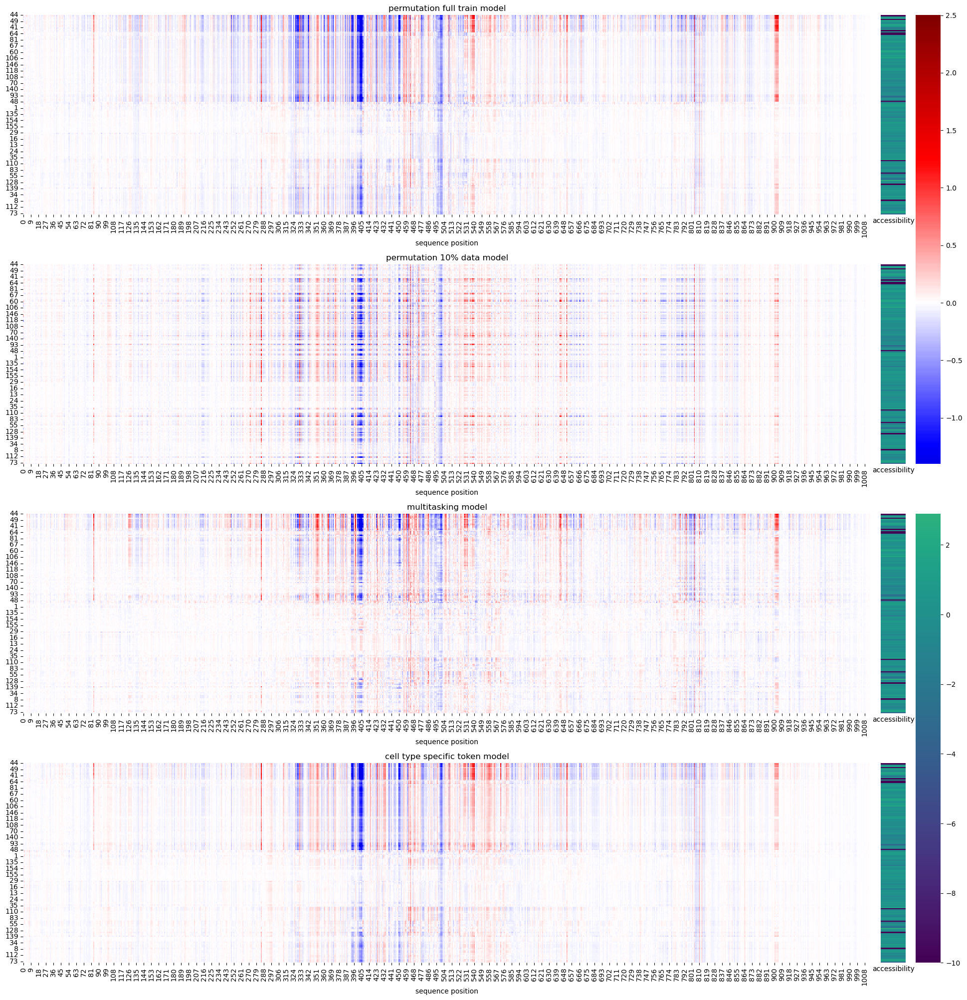

In [10]:
#let's actually just use the heatmap and go all the way!
def multi_cluster(results_list, true_values, name_list, cluster_index = 0, align_indices = True):
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    #uses index to determine which model in results list is used for clustering
    i = results_list[cluster_index]
    g = sns.clustermap(i.sum(axis=0).T, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
    row_order = g.dendrogram_row.reordered_ind
    plt.close(g.figure)

    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap
    temp_true = true_values[row_order].unsqueeze(1)

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        temp_values = i.sum(axis=0).T
        if align_indices:
            if utils_list[j].mtype == 'DNase':
                temp_values = temp_values[:,7:]
            elif utils_list[j].mtype == 'DNase_allcelltypes':
                temp_values = temp_values[:,3:-4]
            elif utils_list[j].mtype == 'DNase_ctst':
                temp_values = temp_values[:,4:-4]

        if j == len(results_list)-1:
            continue

        sns.heatmap(temp_values[row_order], cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model')
        ax_main.set_yticks(range(0,161,5))
        ax_main.set_yticklabels(row_order[::5])

        # Create axes for secondary heatmap (true_values)
        # temp_true = true_values[row_order].unsqueeze(1)
        sns.heatmap(temp_true, cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  

    #let's redraw the last one so we can easily draw the colorbars
    sns.heatmap(temp_values[row_order], cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model')
    #now set the ytick labels to row_order
    ax_main.set_yticks(range(0,161,5))
    ax_main.set_yticklabels(row_order[::5])

    sns.heatmap(temp_true, cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')

multi_cluster(results_list, true_values, name_list)
# plt.suptitle('ISM results clustered by index 0')

In [ ]:
#and let's do the logoplot, and give it the option to align
#and make it pretty
def multi_logo(utils_list,title_list, ccre, startend=None, heights_list = None):
    # utils list should be a list of the ISMUtils class
    # title list should be a list of the titles you want
    # ccre is the ccre number of that split
    # startend is the start and end of the sequence, if none, will use the middle 100. Note that it adjusts DNase and DNase_ctst slightly, it aligns to the multitasking model!
    # heights list is the list of heights, if none, will use the default heights which is just the mean over all celltypes of the ISM scores
    fig, ax = plt.subplots(len(utils_list),1, figsize = (20,len(utils_list)*3))
    tempccre = ccre
    for j,i in enumerate(utils_list):
        if i.mtype == 'DNase' or i.mtype == 'DNase_ctst':
            tempccre = 161*ccre
        else:
            tempccre = ccre
        a,b = i.dataset[tempccre]

        #now we will check to see if it's none, if so we will use the middle
        if startend is None:
            start = i.middle-50
            end = i.middle+50
        else:
            start = startend[0]
            end = startend[1]
        
        #now we can adjust the start and end
        #note we could cut the sequence, but this is literally just identical, it doesn't matter at all
        if i.mtype == 'DNase': #if specify it, add 4 to the dnase, just so aligns with the multitasking model
            start = start+4
            end = end+4
        try:
            seq=i.dataset.tokenizer.decode(a)
        except:
            seq=i.dataset.tokenizer.decode(a[1:]) #hack to deal with DNase_ctst which is same sequence as multitasking but with an extra token

        #now we can define cut_seq
        cut_seq = seq[start:end]
        if heights_list is None:
            heights = i.default_heights(results_list[j])
        else:
            heights = heights_list[j]

        #now we define cut heights
        heights = heights[start:end]
        if True:
            heights = -heights
        logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)

        # Fill the DataFrame with heights, converting heights to float if necessary
        for i, symbol in enumerate(cut_seq):
            logo_df.loc[i, symbol] = heights[i]

        # Generate the sequence logo
        logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below = True, ax = ax.flatten()[j])
        #now set the title
        ax.flatten()[j].set_title(f'{title_list[j]} model')
    plt.tight_layout()
    return fig, ax

multi_logo(utils_list,name_list,15, (858,962))

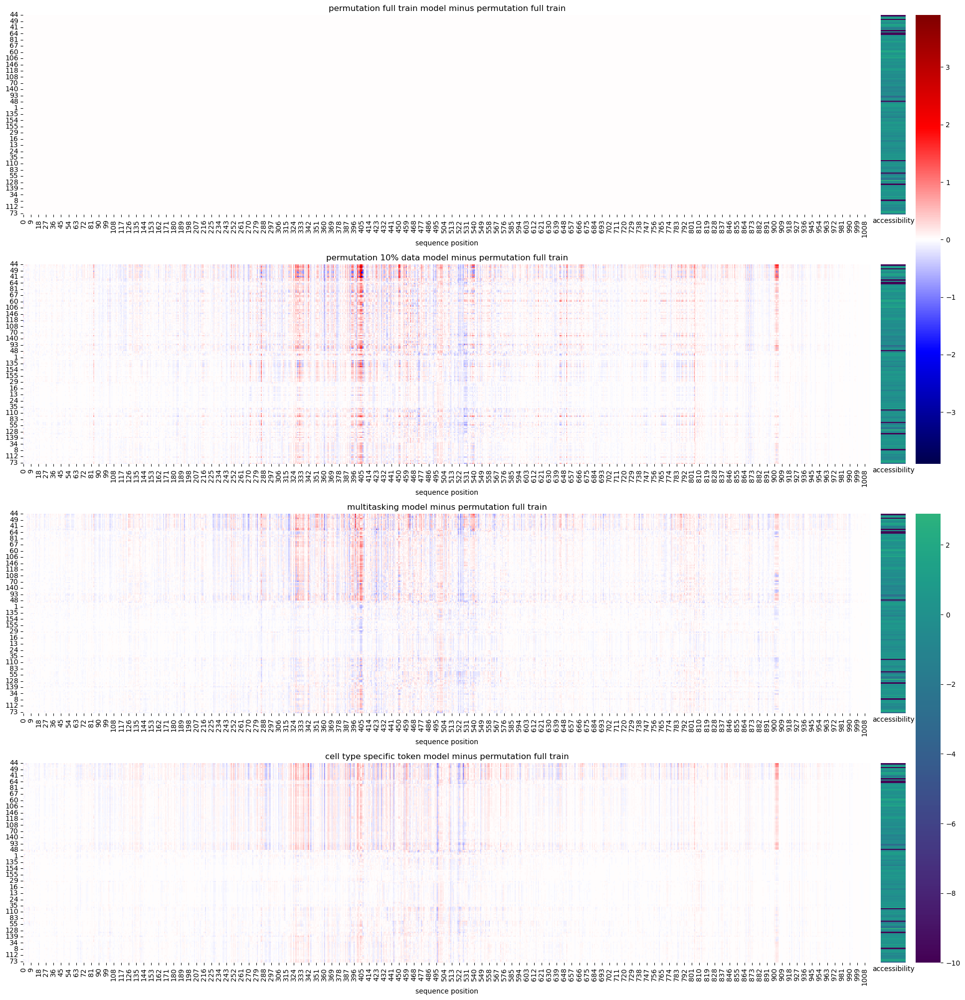

In [23]:
#start with aligning
#here's what we know from the multilogo

def multi_cluster_comparison(utils_list, results_list, true_values, name_list, cluster_index = 0, return_vals = False):
    #here cluster index is used to find which one clusters but also which one we find the difference compared to
    #so like if 0, that one will be all zeros and is the one that is used for clustering
    #this differs from the difference, not just the difference, we instead will find relative change
    global_min = min([i.min() for i in results_list])
    global_max = max([i.max() for i in results_list])
    #find the maximum
    max1 = global_max - global_min
    max2 = np.abs(global_min-global_max)
    max3 = max(max1,max2)

    #now we set it 
    global_min = -max3
    global_max = max3

    #uses index to determine which model in results list is used for clustering
    i = results_list[cluster_index]
    temp_values = i.sum(axis=0).T
    if utils_list[cluster_index].mtype == 'DNase':
        temp_values = temp_values[:,7:]
    elif utils_list[cluster_index].mtype == 'DNase_allcelltypes':
        temp_values = temp_values[:,3:-4]
    elif utils_list[cluster_index].mtype == 'DNase_ctst':
        temp_values = temp_values[:,4:-4]
    
    g = sns.clustermap(temp_values, cmap = 'seismic', center = 0,col_cluster=False, vmin=global_min, vmax=global_max, figsize=(20,5), cbar_pos = (.02,.1,.05,.8))
    row_order = g.dendrogram_row.reordered_ind
    real = temp_values[row_order]
    real_sign = np.sign(real)
    plt.close(g.figure)

    fig = plt.figure(figsize=(20, 5*len(results_list)))
    # from matplotlib.colors import TwoSlopeNorm

    # Dimensions for main and secondary heatmaps
    main_heatmap_width = 0.85
    secondary_heatmap_width = 0.025
    colorbar_width = .025
    gap_between_heatmaps = 0.01
    height = 0.8/len(results_list)  # Adjust based on your preference for the subplot height
    vertical_gap = 0.2/len(results_list)  # Gap between rows

    main_left = 0.05  # Starting position of the main heatmap (left)
    secondary_left = main_left + main_heatmap_width + gap_between_heatmaps  # Starting position of secondary heatmap (left)
    tertiary_left = secondary_left + colorbar_width + gap_between_heatmaps  # Starting position of the colorbars (left)
    total_vertical_space_per_heatmap = height + vertical_gap
    temp_true = true_values[row_order].unsqueeze(1)

    difference_list = []

    for j, i in enumerate(results_list):
        # Calculate positions of main and secondary heatmaps    
        bottom = 0.1 + (height + vertical_gap) * (len(results_list) - 1 - j)  # Starting position from bottom, adjust for each row
        # bottom = 1 - (vertical_gap + (j+1) * total_vertical_space_per_heatmap) #doesn't work, let's figure out why

        # Create axes for main heatmap
        ax_main = fig.add_axes([main_left, bottom, main_heatmap_width, height])
        ax_secondary = fig.add_axes([secondary_left, bottom, secondary_heatmap_width, height])

        temp_values = i.sum(axis=0).T
        #now let's align them all, required to subtract them
        if utils_list[j].mtype == 'DNase':
            temp_values = temp_values[:,7:]
        elif utils_list[j].mtype == 'DNase_allcelltypes':
            temp_values = temp_values[:,3:-4]
        elif utils_list[j].mtype == 'DNase_ctst':
            temp_values = temp_values[:,4:-4]

        #first we will do the sign elementwise multiplication
        temp_sign = np.sign(temp_values[row_order])
        #now elementwise multiply them
        signs = temp_sign*real_sign
        scales = np.abs(temp_values[row_order]-real)
        
        if j == len(results_list)-1:
            continue

        sns.heatmap(signs*scales, cmap='seismic', center=0, ax=ax_main, cbar=False, vmin=global_min, vmax=global_max)
        difference_list.append(temp_values[row_order]-real)
        
        ax_main.set_xlabel('sequence position')
        ax_main.set_title(f'{name_list[j]} model minus {name_list[cluster_index]}')
        ax_main.set_yticks(range(0,161,5))
        ax_main.set_yticklabels(row_order[::5])

        # Create axes for secondary heatmap (true_values)
        #now we can also organize the true_values
        
        sns.heatmap(temp_true, cmap='viridis', center=0, ax=ax_secondary, cbar=False, vmin=min(true_values), vmax=max(true_values))
        # Optional: Remove y-axis labels for the secondary heatmap if they're redundant
        ax_secondary.set_yticks([])
        ax_secondary.set_xticks([])
        ax_secondary.set_xlabel('accessibility')

    fig.subplots_adjust(right=0.9)
    cbar_ax1 = fig.add_axes([tertiary_left, 0.1, 0.025, 0.45])  # Adjust the dimensions as needed
    # sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(true_values), vmax=max(true_values)))
    # fig.colorbar(sm, cax=cbar_ax1)
    cbar_ax = fig.add_axes([tertiary_left, 0.6, 0.025, 0.45])  # Adjust the dimensions as needed
    
    sns.heatmap(signs*scales, cmap='seismic', center=0, ax=ax_main, vmin=global_min, vmax=global_max, cbar_ax = cbar_ax)
    difference_list.append(temp_values[row_order]-real)
    ax_main.set_xlabel('sequence position')
    ax_main.set_title(f'{name_list[j]} model minus {name_list[cluster_index]}')    #now set the ytick labels to row_order
    ax_main.set_yticks(range(0,161,5))
    ax_main.set_yticklabels(row_order[::5])

    sns.heatmap(temp_true, cmap='viridis', center=0, ax=ax_secondary, vmin=min(true_values), vmax=max(true_values), cbar_ax = cbar_ax1)
    ax_secondary.set_yticks([])
    ax_secondary.set_xticks([])
    ax_secondary.set_xlabel('accessibility')
    if return_vals:
        return difference_list

multi_cluster_comparison(utils_list, results_list, true_values, name_list)

(<Figure size 2000x1200 with 4 Axes>,
 array([<Axes: title={'center': 'permutation full train model'}>,
        <Axes: title={'center': 'permutation 10% data model'}>,
        <Axes: title={'center': 'multitasking model'}>,
        <Axes: title={'center': 'cell type specific token model'}>],
       dtype=object))

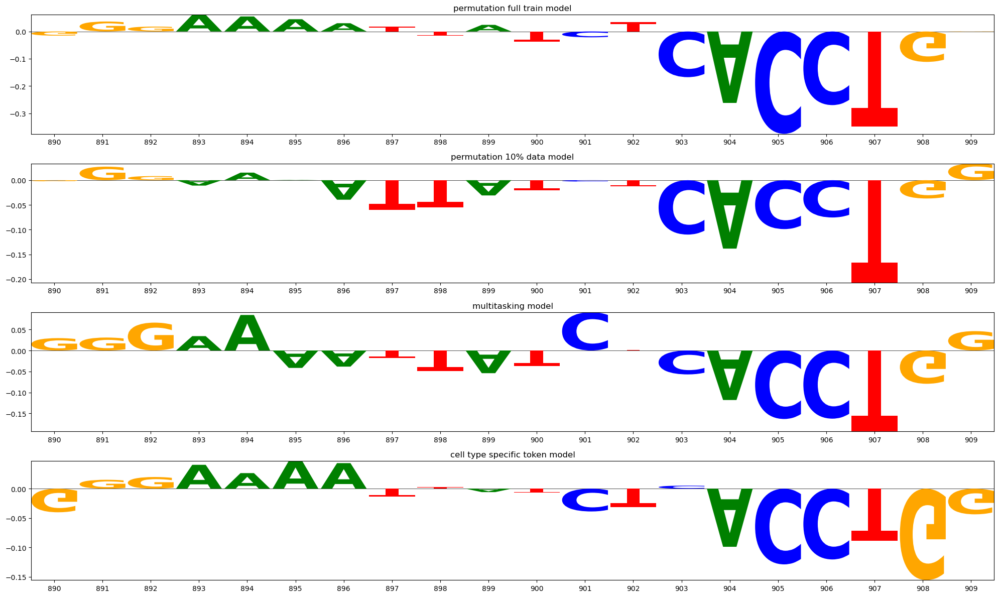

In [22]:
import pandas as pd
import logomaker
def multi_logo(utils_list,title_list, ccre, startend=None, heights_list = None, results_list = None):
    # utils list should be a list of the ISMUtils class
    # title list should be a list of the titles you want
    # ccre is the ccre number of that split
    # startend is the start and end of the sequence, if none, will use the middle 100. Note that it adjusts DNase and DNase_ctst slightly, it aligns to the multitasking model!
    # heights list is the list of heights, if none, will use the default heights which is just the mean over all celltypes of the ISM scores
    # results list is a list of results, and that is used as the heights if no heights are provided, but one must be given
    fig, ax = plt.subplots(len(utils_list),1, figsize = (20,len(utils_list)*3))
    tempccre = ccre
    for j,i in enumerate(utils_list):
        if i.mtype == 'DNase' or i.mtype == 'DNase_ctst':
            tempccre = 161*ccre
        else:
            tempccre = ccre
        a,_ = i.dataset[tempccre]

        #now we will check to see if it's none, if so we will use the middle
        if startend is None:
            start = i.middle-50
            end = i.middle+50
        else:
            start = startend[0]
            end = startend[1]
        
        #now we can adjust the start and end
        #note we could cut the sequence, but this is literally just identical, it doesn't matter at all
        if i.mtype == 'DNase': #if specify it, add 4 to the dnase, just so aligns with the multitasking model
            start = start+4
            end = end+4
        try:
            seq=i.dataset.tokenizer.decode(a)
        except:
            seq=i.dataset.tokenizer.decode(a[1:]) #hack to deal with DNase_ctst which is same sequence as multitasking but with an extra token for the celltype

        #now we can define cut_seq
        cut_seq = seq[start:end]
        if heights_list is None:
            heights = i.default_heights(results_list[j])
        else:
            heights = heights_list[j]

        #now we define cut heights
        heights = heights[start:end]
        if True:
            heights = -heights
        logo_df = pd.DataFrame(0, index=np.arange(len(cut_seq)), columns=list(set(cut_seq)), dtype=float)

        # Fill the DataFrame with heights, converting heights to float if necessary
        for idx, symbol in enumerate(cut_seq):
            logo_df.loc[idx, symbol] = heights[idx]

        # Generate the sequence logo
        logo = logomaker.Logo(logo_df, color_scheme='classic', flip_below = True, ax = ax.flatten()[j])
        #now set the title
        ax.flatten()[j].set_title(f'{title_list[j]} model')
        if i.mtype == 'DNase': #set it back to what it was before, so that the numbers themselves are consistent
            start = start-4
            end = end-4
        ax.flatten()[j].set_xticks(range(0,int(end-start),int((end-start)/20)))
        ax.flatten()[j].set_xticklabels(range(int(start), int(end),int((end-start)/20)))
    plt.tight_layout()
    return fig, ax
# heights_list = 
multi_logo(utils_list,name_list,15,startend=(890,910),results_list = results_list)